# **DroneVision: Secure Drone Segmentation for Rescue and Defense**
# **Group Members**
Bharath Kumar Gopu - EY53339

Sai Kiran Mandula - LN73970

## **Research Question**
How can drone-captured aerial images be used to segment and detect critical objects (such as people, vehicles, and infrastructure), even when images exhibit lighting variations or are blurry, to assist in faster and more efficient rescue and defence operations?

## **Revised Research Question**
This refined question emphasizes the challenge of maintaining segmentation accuracy despite poor image quality, such as lighting issues or blurry images. Addressing this will ensure that the model performs reliably in real-world rescue operations.

## **Background**
In response to the increasing demand for rapid and precise actions in rescue and defence operations, drones offer a promising solution for capturing real-time aerial imagery. However, the challenge lies in accurately identifying and segmenting key objects from this data. Our research focuses on developing robust segmentation models that can perform well even under challenging conditions.

We will study semantic segmentation Simple FCN, FPN and modelsk R-CNN and investigate how **DroneSegNet** can handle noise and degraded image quality. These insights will inform our strategy to ensure our model is resilient to environmental variations, such as poor lighting or motion blur, which are common in drone-captured images.

This project seeks to develop a system capable of processing drone images for object detection and segmentation, focusing on locating people during emergencies and spotting potential threats in restricted areas. The system's functionality will be expanded by incorporating a web app for user interaction and potential Power BI integration for data visualization.

## **Key Concepts**
- **Semantic Segmentation**
- **Object Detection**
- **Rescue Operations**
- **Defense Surveillance**

## **Semantic Drone Dataset**

The [Semantic Drone Dataset](http://dronedataset.icg.tugraz.at/) focuses on the semantic understanding of urban environments. It includes high-resolution imagery captured from altitudes of 5 to 30 meters, featuring more than 20 houses viewed from a nadir (bird's eye) perspective. Each image has a resolution of **6000x4000 pixels** (24 MP).

- **Training Set**: 400 publicly available images
- **Test Set**: 200 private images

![Semantic Drone Dataset](https://www.tugraz.at/fileadmin/_migrated/pics/fyler3.png)

## **Semantic Annotation**

The dataset provides dense annotations for each image using polygons. These annotations cover **24 distinct classes**:

- **Unlabeled**
- **Paved Area**
- **Dirt**
- **Grass**
- **Gravel**
- **Water**
- **Rocks**
- **Pool**
- **Vegetation**
- **Roof**
- **Wall**
- **Window**
- **Door**
- **Fence**
- **Fence Pole**
- **Person**
- **Dog**
- **Car**
- **Bicycle**
- **Tree**
- **Bald Tree**
- **AR Marker**
- **Obstacle**
- **Conflicting**

## **Included Data**

The dataset contains various files and formats to support your research and applications:

- **Training Images**: 400 high-resolution images for model training.
- **Dense Semantic Annotations**:
  - PNG format: Located in `training_set/gt/semantic/label_images/`
  - Processed masks (not part of the original dataset): Located in `training_set/gt/semantic/processed_label_images/`
- **LabelMe XML Files**: Dense semantic annotations can be found in `training_set/gt/semantic/label_me_xml/`
- **Semantic Class Definitions**: Available in `training_set/gt/semantic/class_dict.csv`
- **Bounding Boxes of Persons**:
  - XML files: Located in `training_set/gt/bounding_box/label_me_xml`
  - Mask images: Located in `training_set/gt/bounding_box/masks`
  - Individual person mask images: Located in `training_set/gt/bounding_box/masks_instances`
  - Python pickle files: Located in `training_set/gt/bounding_box/bounding_boxes/person/`


# 1. Data Acquisition

In [ ]:

import numpy as np
import pandas as pd
import os
import cv2

IMAGE_PATH = '../input/semantic-drone-dataset/dataset/semantic_drone_dataset/original_images/'
MASK_PATH = '../input/semantic-drone-dataset/RGB_color_image_masks/RGB_color_image_masks'


max_images = 50  # Set this to the number of images you want to process

def check_image_dimensions(IMAGE_PATH, max_images=50):
    dimensions = []
    count = 0

    # Iterate through images with a limit
    for image_file in os.listdir(IMAGE_PATH):
        if image_file.endswith('.jpg'):
            image_path = os.path.join(IMAGE_PATH, image_file)
            image = cv2.imread(image_path)
            dimensions.append(image.shape)
            count += 1

            # Stop once the desired number of images is processed
            if count >= max_images:
                break

    # Print unique image dimensions
    unique_dimensions = set(dimensions)
    print(f"Unique image dimensions: {unique_dimensions}")

check_image_dimensions(IMAGE_PATH, max_images=max_images)


n_classes = 23

def create_df():
    name = []
    for dirname, _, filenames in os.walk(IMAGE_PATH):
        for filename in filenames:
            name.append(filename.split('.')[0])

    return pd.DataFrame({'id': name}, index = np.arange(0, len(name)))

df = create_df()
print('Total Images: ', len(df))

Unique image dimensions: {(4000, 6000, 3)}
Total Images:  400


In [ ]:
class_dict_path = '/kaggle/input/semantic-drone-dataset/class_dict_seg.csv'

class_dict_df = pd.read_csv(class_dict_path)
print(class_dict_df)

           name    r    g    b
0     unlabeled    0    0    0
1    paved-area  128   64  128
2          dirt  130   76    0
3         grass    0  102    0
4        gravel  112  103   87
5         water   28   42  168
6         rocks   48   41   30
7          pool    0   50   89
8    vegetation  107  142   35
9          roof   70   70   70
10         wall  102  102  156
11       window  254  228   12
12         door  254  148   12
13        fence  190  153  153
14   fence-pole  153  153  153
15       person  255   22   96
16          dog  102   51    0
17          car    9  143  150
18      bicycle  119   11   32
19         tree   51   51    0
20    bald-tree  190  250  190
21    ar-marker  112  150  146
22     obstacle    2  135  115
23  conflicting  255    0    0


# 2. Exploratory Data Analysis:

### Visualizing the color mapping for classes

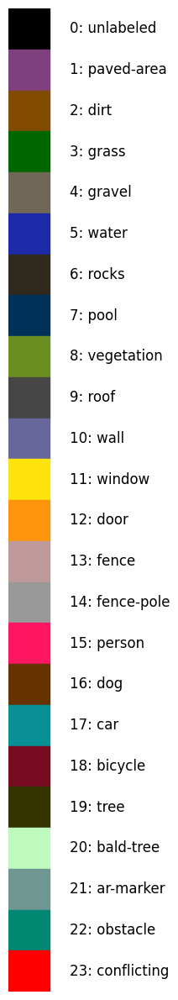

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Strip any leading/trailing spaces from column names
class_dict_df.columns = class_dict_df.columns.str.strip()

# Now iterate through the DataFrame
for i, row in class_dict_df.iterrows():
    r, g, b = row['r'], row['g'], row['b']

# Function to plot color mapping
def plot_color_mapping(data):
    # Extract RGB values and class names from the DataFrame
    COLOR_MAPPING = {
        (row['r'], row['g'], row['b']): index for index, row in data.iterrows()
    }
    LABEL_NAMES = {
        index: row['name'] for index, row in data.iterrows()
    }

    # Create a figure and axis
    fig, ax = plt.subplots(1, 1, figsize=(6, len(COLOR_MAPPING) * 0.5))

    # Iterate through each color and label
    for i, ((r, g, b), class_id) in enumerate(COLOR_MAPPING.items()):
        # Normalize RGB values to the 0-1 range for matplotlib
        color = [r / 255, g / 255, b / 255]

        # Create a rectangle patch for the color
        rect = plt.Rectangle((0, i), 1, 1, color=color)
        ax.add_patch(rect)

        # Display the class label text
        text = f"{class_id}: {LABEL_NAMES[class_id]}"
        ax.text(1.5, i + 0.5, text, verticalalignment='center', fontsize=12)

    # Remove axes
    ax.axis('off')

    # Set the aspect ratio to ensure the rectangles remain square
    ax.set_aspect('equal')

    # Adjust the plot limits based on the number of colors
    ax.set_xlim([0, 3])
    ax.set_ylim([0, len(COLOR_MAPPING)])

    # Invert the y-axis so the first class appears at the top
    ax.invert_yaxis()

    # Display the plot
    plt.tight_layout()
    plt.show()

# Call the plotting function
plot_color_mapping(class_dict_df)


###  Mask Class Occurrence Checker

In [ ]:
from collections import defaultdict

# Resize mask function to optimize processing
def resize_mask(mask, target_size=(1024, 1024)):
    return cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)

# Function to check class occurrence in a subset of images
def check_class_occurrence_fast(MASK_PATH, class_dict, max_images=50, resize=False):
    class_occurrence = defaultdict(list)

    # Create color mappings from the class dictionary
    class_colors = {row['name']: (row['r'], row['g'], row['b']) for _, row in class_dict.iterrows()}

    count = 0  # Track processed images
    for mask_file in os.listdir(MASK_PATH):
        if mask_file.endswith('.png'):
            mask_path = os.path.join(MASK_PATH, mask_file)
            mask = cv2.imread(mask_path)

            # Resize mask if required
            if resize:
                mask = resize_mask(mask)

            # Check class presence in the mask
            for class_name, (r, g, b) in class_colors.items():
                class_mask = np.all(mask == [b, g, r], axis=-1)
                if np.any(class_mask):
                    class_occurrence[mask_file].append(class_name)

            count += 1
            if count >= max_images:  # Stop after processing the specified number of images
                break

    # Display the results
    for mask_file, classes in class_occurrence.items():
        print(f"Image {mask_file} contains the following classes: {classes}")



# Call the function with a limit of 50 images (you can change this number)
check_class_occurrence_fast(MASK_PATH, class_dict_df, max_images=50, resize=True)

Image 173.png contains the following classes: ['unlabeled', 'paved-area', 'dirt', 'grass', 'gravel', 'water', 'rocks', 'vegetation', 'roof', 'wall', 'window', 'fence', 'person', 'bicycle', 'tree', 'obstacle']
Image 491.png contains the following classes: ['unlabeled', 'paved-area', 'rocks', 'vegetation', 'person', 'obstacle']
Image 043.png contains the following classes: ['unlabeled', 'paved-area', 'dirt', 'grass', 'gravel', 'rocks', 'vegetation', 'roof', 'wall', 'window', 'fence-pole', 'person', 'tree', 'obstacle']
Image 248.png contains the following classes: ['unlabeled', 'paved-area', 'dirt', 'grass', 'rocks', 'vegetation', 'wall', 'fence', 'fence-pole', 'person', 'bicycle', 'bald-tree', 'ar-marker', 'obstacle']
Image 038.png contains the following classes: ['unlabeled', 'paved-area', 'dirt', 'grass', 'gravel', 'rocks', 'roof', 'wall', 'window', 'door', 'fence', 'fence-pole', 'person', 'bicycle', 'tree', 'ar-marker', 'obstacle']
Image 480.png contains the following classes: ['unlab

###  Class Occurrence Analysis in Semantic Masks with Resizing Functionality

- This section contains a code implementation for checking the occurrence of different classes in mask images from the Semantic Drone Dataset. The process includes resizing the masks for optimized processing and visualizing the class occurrences.

Using device: cuda


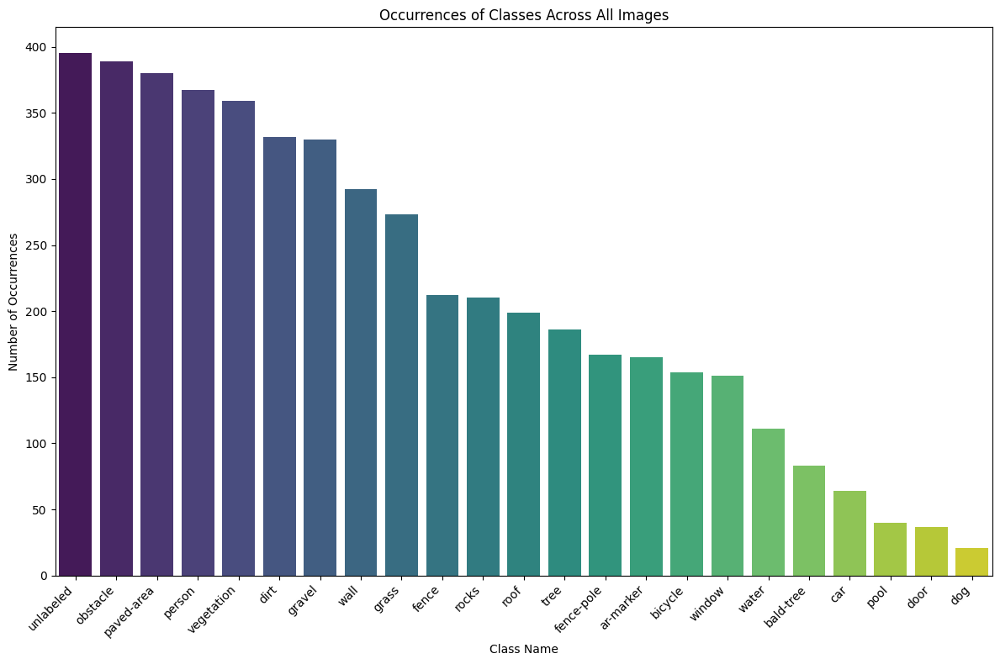

In [ ]:
import numpy as np
import cv2
import os
import torch
from collections import defaultdict
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Paths to dataset
MASK_PATH = '/kaggle/input/semantic-drone-dataset/RGB_color_image_masks/RGB_color_image_masks'
CLASS_DICT_PATH = '/kaggle/input/semantic-drone-dataset/class_dict_seg.csv'

# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Resize mask function to optimize processing
def resize_mask(mask, target_size=(1024, 1024)):
    """Resize the mask to the target size for faster computation."""
    return cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)

# Function to check class occurrence for all images using GPU if available
def check_class_occurrence(mask_folder, class_dict, resize=False):
    """Check the occurrence of classes in all images."""
    class_occurrence = defaultdict(list)

    # Extract RGB values for each class from the class dictionary
    class_colors = {
        row['name']: (row['r'], row['g'], row['b']) for _, row in class_dict.iterrows()
    }

    for mask_file in os.listdir(mask_folder):
        if mask_file.endswith('.png'):
            mask_path = os.path.join(mask_folder, mask_file)
            mask = cv2.imread(mask_path)

            # Resize the mask if the option is enabled
            if resize:
                mask = resize_mask(mask)

            # Convert mask to tensor and move to GPU if available
            mask_tensor = torch.tensor(mask, device=device)

            # Check for the presence of each class in the mask
            for class_name, (r, g, b) in class_colors.items():
                color_tensor = torch.tensor([b, g, r], device=device)
                class_mask = torch.all(mask_tensor == color_tensor, dim=-1)
                if torch.any(class_mask):
                    class_occurrence[mask_file].append(class_name)

    return class_occurrence

# Load the class dictionary
class_dict_df = pd.read_csv(CLASS_DICT_PATH)
class_dict_df.columns = class_dict_df.columns.str.strip()

# Call the function without limiting the number of images
class_occurrence = check_class_occurrence(MASK_PATH, class_dict_df, resize=True)

# Flatten the dictionary to count occurrences of each class
all_classes = [class_name for classes in class_occurrence.values() for class_name in classes]
class_counts = pd.Series(all_classes).value_counts()

# Plot the occurrences of each class across all processed images
plt.figure(figsize=(12, 8))
sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
plt.title("Occurrences of Classes Across All Images")
plt.xlabel("Class Name")
plt.ylabel("Number of Occurrences")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


### Pie Chart Visualization of Class Proportions in Semantic Masks

This section visualizes the proportion of each class across the processed images using a pie chart, providing insights into the distribution of classes in the dataset

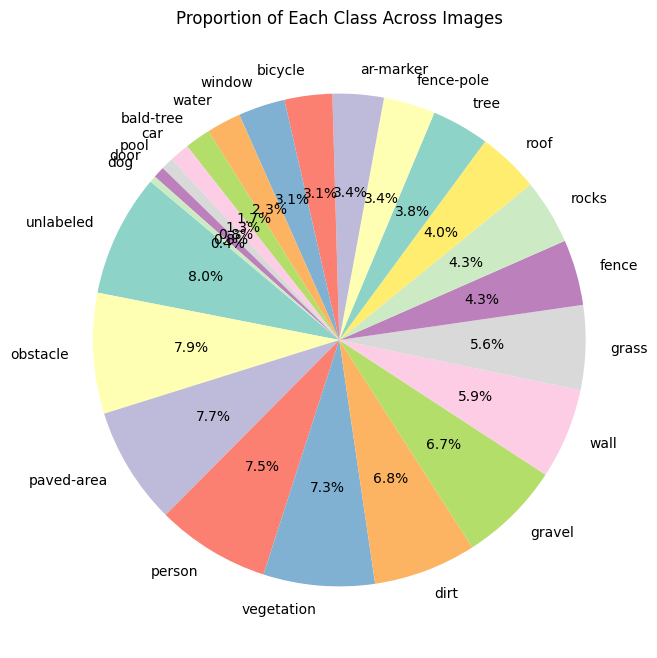

In [ ]:
# Plot pie chart
plt.figure(figsize=(8, 8))
plt.pie(class_counts.values, labels=class_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("Set3"))
plt.title("Proportion of Each Class Across Images")
plt.show()


### Visualization of Class Occurrences in Semantic Masks

In this section, we visualize the class occurrences in a sample mask image by overlaying colors corresponding to each class. This helps in understanding the distribution of classes within the mask.

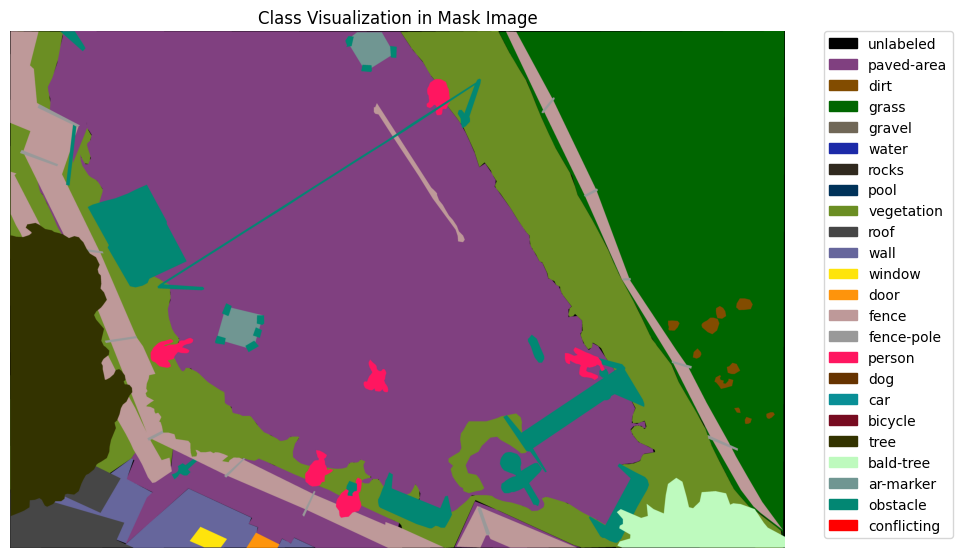

In [ ]:
import matplotlib.patches as mpatches

# Resize mask function to optimize processing
def resize_mask(mask, target_size=(1024, 1024)):
    """Resize the mask to the target size for faster computation."""
    return cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)

# Function to visualize classes on an image
def visualize_class_occurrence(mask_path, class_dict):
    """Overlay each class in a mask with its corresponding color."""
    mask = cv2.imread(mask_path)
    if mask is None:
        raise FileNotFoundError(f"Mask file not found: {mask_path}")

    # Convert the mask from BGR to RGB
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)

    # Create a blank image for visualization
    vis_image = np.zeros_like(mask)

    # Extract RGB values for each class from the class dictionary
    class_colors = {
        row['name']: (row['r'], row['g'], row['b']) for _, row in class_dict.iterrows()
    }

    # Apply each class color to the blank image where that class is present in the mask
    for class_name, (r, g, b) in class_colors.items():
        # Check if the color is found in the mask
        class_mask = np.all(mask == [r, g, b], axis=-1)
        if np.any(class_mask):
            vis_image[class_mask] = [r, g, b]
        else:
            print(f"Warning: Color {r, g, b} for class '{class_name}' not found in the mask.")

    return vis_image, class_colors

# Load the class dictionary
class_dict_df = pd.read_csv(CLASS_DICT_PATH)
class_dict_df.columns = class_dict_df.columns.str.strip()

# Define a sample mask file for visualization
sample_mask_file = os.path.join(MASK_PATH, '001.png')  # Update this filename as needed

# Generate visualization
vis_image, class_colors = visualize_class_occurrence(sample_mask_file, class_dict_df)

# Plot the image with a legend for each class color
plt.figure(figsize=(10, 10))
plt.imshow(vis_image)
plt.axis('off')

# Create a color legend
patches = [mpatches.Patch(color=np.array(color)/255.0, label=class_name)
           for class_name, color in class_colors.items()]
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc="upper left", borderaxespad=0.)
plt.title("Class Visualization in Mask Image")
plt.show()


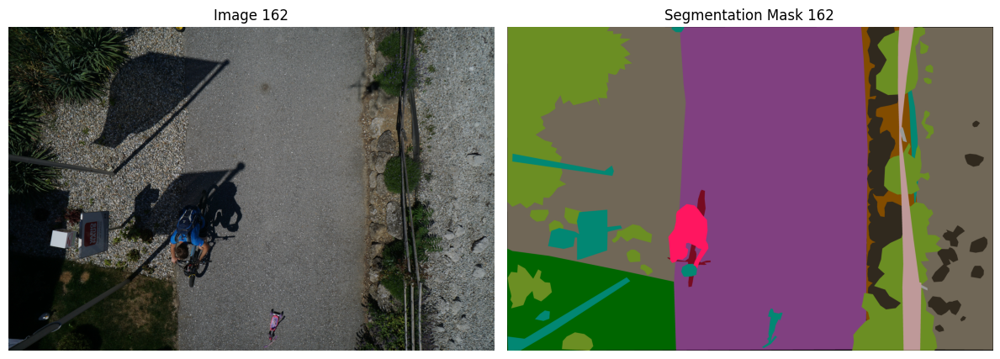

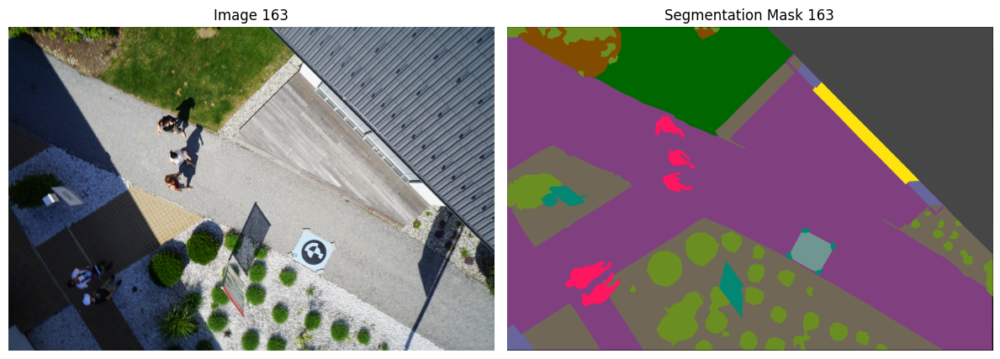

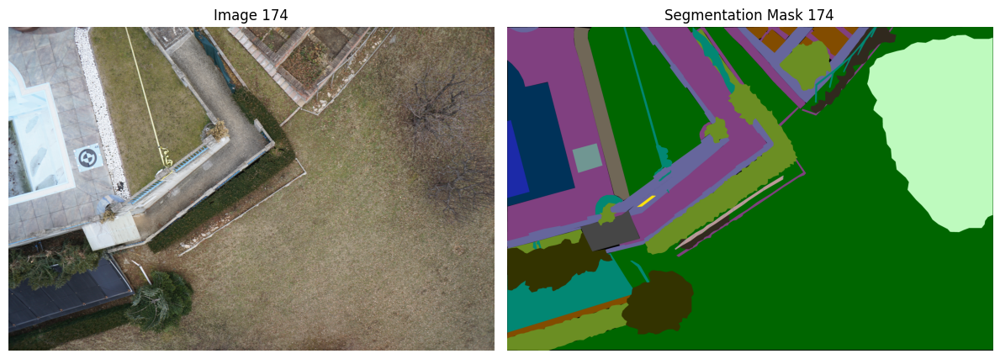

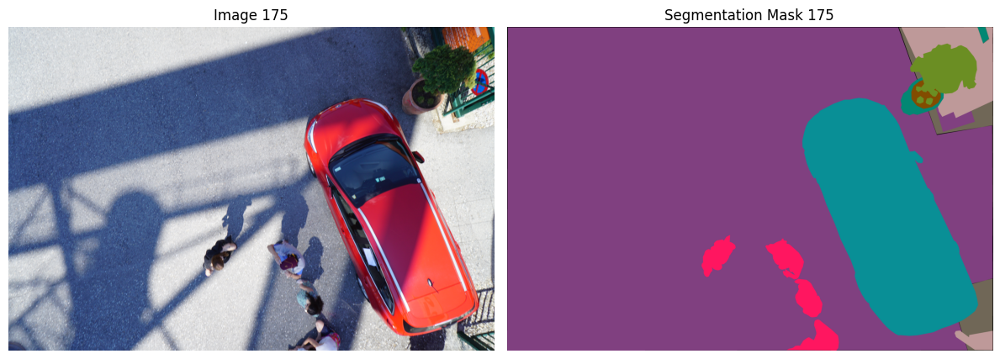

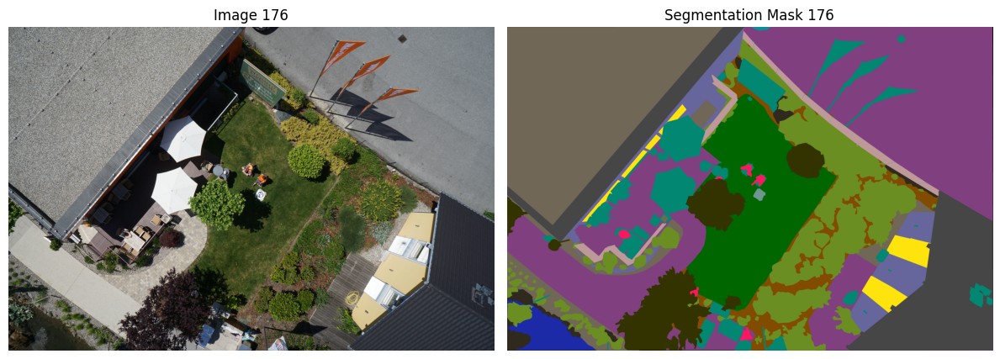

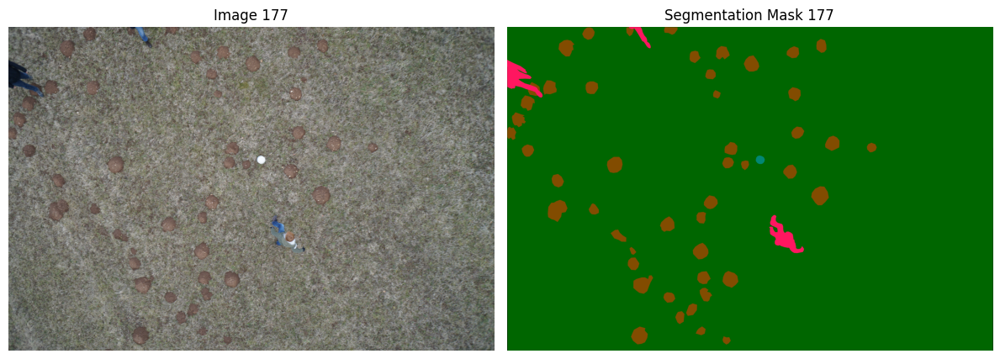

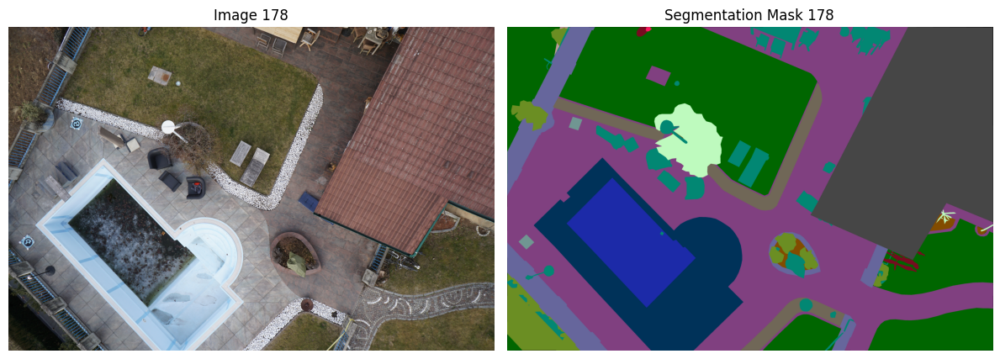

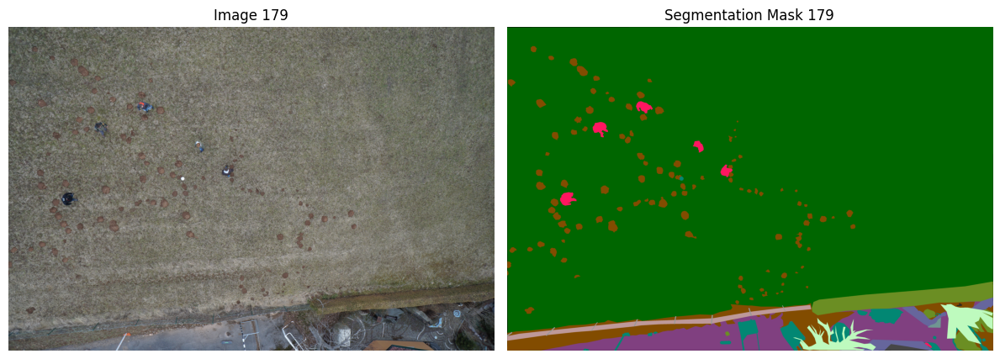

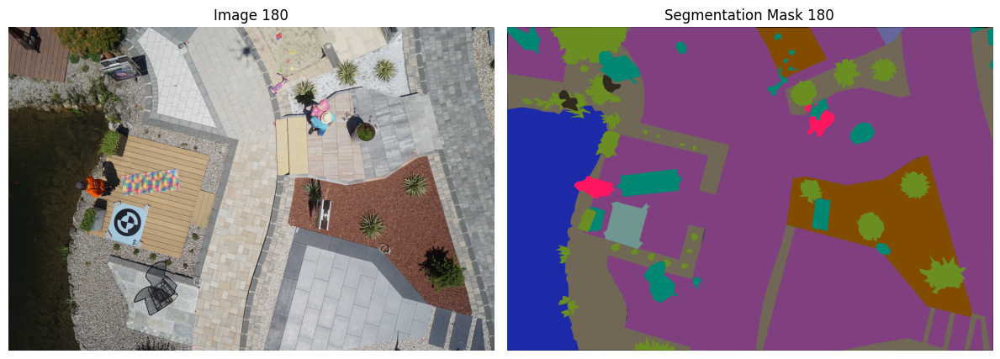

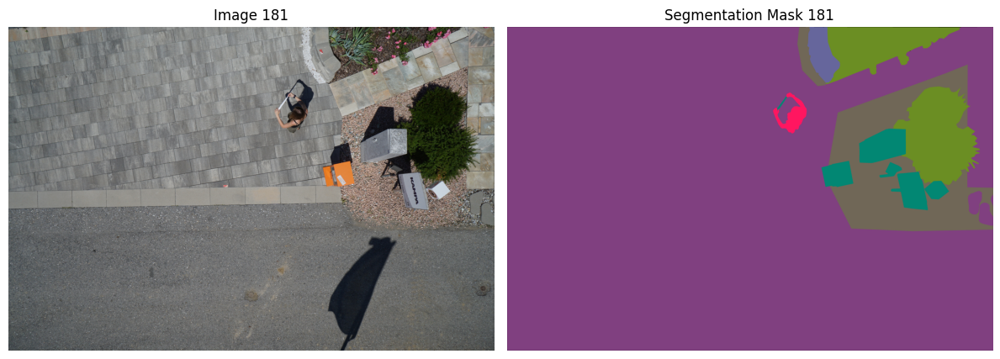

In [ ]:
def visualize_image_and_mask(image_id, class_dict):
    # Construct file paths with appropriate extensions
    image_path = os.path.join(IMAGE_PATH, f"{image_id}.jpg")
    mask_path = os.path.join(MASK_PATH, f"{image_id}.png")

    # Load the image and mask
    image = cv2.imread(image_path)
    mask = cv2.imread(mask_path)

    # Check if the image and mask were loaded correctly
    if image is None:
        print(f"Error loading image: {image_path}")
        return
    if mask is None:
        print(f"Error loading mask: {mask_path}")
        return

    # Convert the mask to the same logic as visualize_class_occurrence
    vis_image, _ = visualize_class_occurrence(mask_path, class_dict)

    # Plot the image and mask side by side
    plt.figure(figsize=(12, 6))

    # Display the original image
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct display
    plt.title(f'Image {image_id}')
    plt.axis('off')

    # Display the processed mask with class colors
    plt.subplot(1, 2, 2)
    plt.imshow(vis_image)
    plt.title(f'Segmentation Mask {image_id}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Example usage
image_ids = [162, 163, 174, 175, 176, 177, 178, 179, 180, 181]
for image_id in image_ids:
    visualize_image_and_mask(image_id, class_dict_df)


# 3. Data Cleaning and Preparation

- Detecting outliers

In [ ]:
import numpy as np
import cv2
import os
from concurrent.futures import ThreadPoolExecutor
import matplotlib.pyplot as plt

# Resize mask function to optimize processing
def resize_mask(mask, target_size=(1024, 1024)):
    """Resize the mask to the target size for faster computation."""
    return cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)

# Function to get image IDs dynamically
def get_image_ids(image_folder, max_images=None):
    """Fetch image IDs from the folder."""
    image_ids = []
    for filename in os.listdir(image_folder):
        if filename.endswith(".jpg"):
            image_id = filename.split(".")[0]  # Extract '001', '011', etc.
            image_ids.append(image_id)
        if max_images and len(image_ids) >= max_images:
            break
    return image_ids

# Function to check lighting variation
def check_lighting_variation(image_path):
    """Calculate the brightness of the image."""
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error loading image: {image_path}")
        return None
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    brightness = np.mean(gray_image)
    return brightness

# Function to check blurriness
def check_image_blurriness(image_path):
    """Calculate the variance of Laplacian to check blurriness."""
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error loading image: {image_path}")
        return None
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    laplacian_var = cv2.Laplacian(gray_image, cv2.CV_64F).var()
    return laplacian_var

# Function to check image dimensions
def check_image_dimensions(image_path, expected_dimensions=(4000, 6000)):
    """Check the dimensions of the image."""
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error loading image: {image_path}")
        return False
    height, width = image.shape[:2]
    return (height, width) == expected_dimensions

# Function to detect outliers in parallel
def detect_outliers(image_ids, image_folder, lighting_threshold=100, blurriness_threshold=100, expected_dimensions=(4000, 6000)):
    outliers = {
        'lighting_variations': [],
        'blurry_images': [],
        'different_aspect_ratios': [],
    }

    def process_image(image_id):
        image_path = os.path.join(image_folder, f"{image_id}.jpg")

        # Check lighting variations
        brightness = check_lighting_variation(image_path)
        if brightness is not None and brightness < lighting_threshold:
            outliers['lighting_variations'].append(image_id)

        # Check blurriness
        blur_value = check_image_blurriness(image_path)
        if blur_value is not None and blur_value < blurriness_threshold:
            outliers['blurry_images'].append(image_id)

        # Check dimensions
        if not check_image_dimensions(image_path, expected_dimensions):
            outliers['different_aspect_ratios'].append(image_id)

    # Use ThreadPoolExecutor for parallel processing
    with ThreadPoolExecutor() as executor:
        executor.map(process_image, image_ids)

    return outliers

# Paths
image_folder = '../input/semantic-drone-dataset/dataset/semantic_drone_dataset/original_images/'

# Fetch image IDs
image_ids = get_image_ids(image_folder)

# Detect outliers
detected_outliers = detect_outliers(image_ids, image_folder)

# Print detected outliers with counts
for outlier_type, ids in detected_outliers.items():
    print(f"{outlier_type}: {ids}")
    print(f"Total {outlier_type}: {len(ids)}")


lighting_variations: ['272', '185', '153', '237', '513', '265', '118', '361', '443', '295', '106', '349', '006', '500', '156', '011', '120', '290', '512', '480', '408', '515', '101', '051', '382', '311', '397', '047', '186', '403', '390', '381', '455', '068', '001', '419', '015', '135', '246', '458', '103', '543', '296', '126', '545', '485', '587', '071', '281', '207', '598', '588', '206', '257', '351', '041', '222', '229', '330', '119', '305', '262', '052', '055', '386', '162', '428', '060', '232', '013', '306', '593', '133', '016', '044', '454', '040']
Total lighting_variations: 77
blurry_images: ['014', '272', '182', '202', '118', '443', '591', '163', '463', '349', '251', '011', '120', '512', '480', '515', '372', '193', '056', '382', '047', '435', '530', '001', '075', '042', '419', '015', '356', '145', '135', '246', '292', '458', '005', '121', '173', '063', '261', '174', '004', '391', '451', '346', '310', '126', '572', '545', '194', '567', '155', '485', '071', '138', '209', '598', '

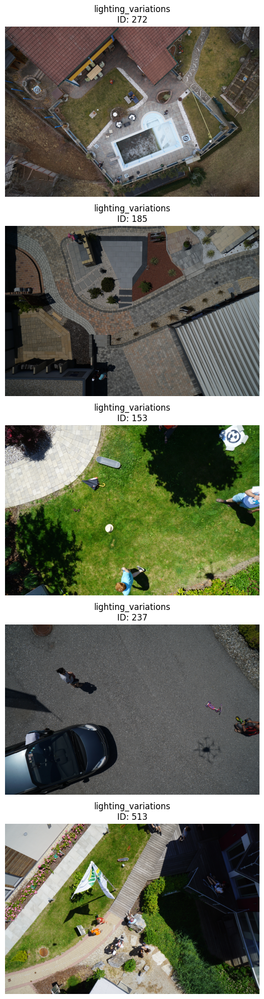

In [ ]:
import math

# Function to load an image given its ID
def load_image(image_id):
    image_path = os.path.join(image_folder, f"{image_id}.jpg")
    return cv2.imread(image_path)

# Function to visualize detected outliers dynamically
def visualize_outliers(outliers, max_images=5):
    # Track the number of images displayed
    images_displayed = 0

    plt.figure(figsize=(15, max_images * 4))

    # Iterate through each type of outlier and its corresponding image IDs
    for outlier_type, ids in outliers.items():
        for image_id in ids:
            if images_displayed >= max_images:
                break

            image = load_image(image_id)
            if image is not None:
                # Convert BGR to RGB
                image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # Display the image
                plt.subplot(max_images, 1, images_displayed + 1)
                plt.imshow(image_rgb)
                plt.title(f"{outlier_type}\nID: {image_id}")
                plt.axis('off')

                images_displayed += 1
            else:
                print(f"Image with ID {image_id} not found.")

        if images_displayed >= max_images:
            break

    plt.tight_layout()
    plt.show()

# Detect outliers using your previously defined function
image_ids = get_image_ids(image_folder)
detected_outliers = detect_outliers(image_ids, image_folder)

# Visualize up to 5 detected outliers
visualize_outliers(detected_outliers, max_images=5)


# Model Training with Outliers

In [ ]:
!pip install kaggle -q
!pip install gradio -q
!pip install segmentation_models_pytorch -q
!pip install scikit-learn -q

In [ ]:
print("Importing libraries...")
import os
import random
import shutil
import torch
import gc
import ssl

import pandas as pd
import numpy as np
import gradio as gr
import matplotlib.pyplot as plt
import segmentation_models_pytorch as smp

import torch.nn as nn
import torch.optim as optim

from PIL import Image
from tqdm.notebook import tqdm
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.functional as TF
from concurrent.futures import ThreadPoolExecutor
from sklearn.model_selection import train_test_split
print("Finished Importing")

Importing libraries...
Finished Importing


In [ ]:
# PARAMETERS DEFINITION

# Set random seed for reproducibility
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

torch.set_printoptions(edgeitems=10)                                    # Set how many elements do the print(tensor) show
ssl._create_default_https_context = ssl._create_unverified_context      # Set ssl context as unverified to avoid SSL errors
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")   # Set compute device to GPU if available, else to CPU

resize_images = True                                                     # Set to True if you want to resize the images to the specified dimensions
download_dataset_from_kaggle = False                                     # Set to True if you want to download the dataset from Kaggle API required
resize_dimensions = (512, 512)                                           # Set the dimensions to resize the images to



# PATHS DEFINITION

# Original dataset paths of (6000x4000 images)
original_images_path = "/kaggle/input/semantic-drone-dataset/dataset/semantic_drone_dataset/original_images"
original_segmentated_rgb_images_path = "/kaggle/input/semantic-drone-dataset/RGB_color_image_masks/RGB_color_image_masks"
original_segmentated_images_path = "/kaggle/input/semantic-drone-dataset/dataset/semantic_drone_dataset/label_images_semantic"

# Reduced size dataset paths (512x512 images)
reduced_images_path = "/kaggle/working/original_images"
reduced_segmentated_rgb_images_path = "/kaggle/working/segmentated_rgb_images"
reduced_segmentated_images_path = "/kaggle/working/segmentated_images"

# CSV file path of images pairs
class_dict_path = "/kaggle/input/semantic-drone-dataset/class_dict_seg.csv"

In [ ]:
# Function to resize a single image
def resize_image(input_output_path_tuple, new_width, new_height, interpolation=Image.LANCZOS):
    input_path, output_path = input_output_path_tuple
    # If the file is an image
    if os.path.isfile(input_path) and input_path.lower().endswith(('.png', '.jpg', '.jpeg')):
        # Open and resize the image
        with Image.open(input_path) as img:
            resized_img = img.resize((new_width, new_height), interpolation)
            resized_img.save(output_path)
    else:
        print(f"Skipped {input_path} as it is not an image.")

# Function to resize all images in a folder
def resize_images_in_folder(input_folder, output_folder, new_width, new_height, interpolation=Image.NEAREST):
    # Create output folder
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # List of input and output paths
    input_output_paths = [(os.path.join(input_folder, filename), os.path.join(output_folder, filename)) for filename in os.listdir(input_folder)]

    # Use ThreadPoolExecutor to parallelize the resizing process
    with ThreadPoolExecutor() as executor:
        list(tqdm(executor.map(lambda p: resize_image(p, new_width, new_height, interpolation), input_output_paths), total=len(input_output_paths)))

# Resize images if needed
if resize_images:
    print("Resizing original images...")
    resize_images_in_folder(original_images_path, "kaggle/working/original_images", resize_dimensions[0], resize_dimensions[1], Image.NEAREST)
    print("Resizing rgb segmented images...")
    resize_images_in_folder(original_segmentated_rgb_images_path, "kaggle/working/segmentated_rgb_images", resize_dimensions[0], resize_dimensions[1], Image.NEAREST)
    print("Resizing grayscale segmented images...")
    resize_images_in_folder(original_segmentated_images_path, "kaggle/working/segmentated_images", resize_dimensions[0], resize_dimensions[1], Image.NEAREST)

    # Create a zip archive of the resized images
    shutil.make_archive("resized_images", 'zip', "kaggle/working/")

Resizing original images...


  0%|          | 0/400 [00:00<?, ?it/s]

Resizing rgb segmented images...


  0%|          | 0/400 [00:00<?, ?it/s]

Resizing grayscale segmented images...


  0%|          | 0/400 [00:00<?, ?it/s]

In [ ]:
import pandas as pd
import os

# Function to create a dataset DataFrame and load class dictionary
def create_dataset_and_load_class_dict(original_images_path, segmented_images_path, segmented_rgb_images_path, class_dict_path):
    # Initialize DataFrame with columns
    df = pd.DataFrame(columns=["image_path", "label_path", "rgb_label_path"])

    row_list = []
    # Walk through the original images folder
    for root, dirs, files in os.walk(original_images_path):
        for file in files:
            if file.endswith((".jpg", ".png")):
                # Define paths for image, label, and RGB label
                image_path = os.path.join(original_images_path, file)
                label_file = file.replace(".jpg", ".png").replace(".jpeg", ".png")
                label_path = os.path.join(segmented_images_path, label_file)
                rgb_label_path = os.path.join(segmented_rgb_images_path, label_file)

                # Append row information to the list
                row_list.append({"image_path": image_path, "label_path": label_path, "rgb_label_path": rgb_label_path})

    # Create DataFrame from the list
    df = pd.DataFrame(row_list)

    # Load classes dictionary as DataFrame
    df_classes = pd.read_csv(class_dict_path)

    return df, df_classes

class_dict_path = '/kaggle/input/semantic-drone-dataset/class_dict_seg.csv'

# Paths for reduced datasets
reduced_images_path = '/kaggle/working/kaggle/working/original_images'
reduced_segmented_rgb_images_path = '/kaggle/working/kaggle/working/segmentated_rgb_images'
reduced_segmented_images_path = '/kaggle/working/kaggle/working/segmentated_images'  # New path for grayscale label images

# Create dataframe of images paths and load class dictionary
df, df_classes = create_dataset_and_load_class_dict(
    reduced_images_path,
    reduced_segmented_images_path,
    reduced_segmented_rgb_images_path,
    class_dict_path
)

# Display the first few rows of the dataset DataFrame
print("Dataset DataFrame:")
print(df.head())

# Display class dictionary
print("\nClasses Dictionary:")
print(df_classes.head())


Dataset DataFrame:
                                          image_path  \
0  /kaggle/working/kaggle/working/original_images...   
1  /kaggle/working/kaggle/working/original_images...   
2  /kaggle/working/kaggle/working/original_images...   
3  /kaggle/working/kaggle/working/original_images...   
4  /kaggle/working/kaggle/working/original_images...   

                                          label_path  \
0  /kaggle/working/kaggle/working/segmentated_ima...   
1  /kaggle/working/kaggle/working/segmentated_ima...   
2  /kaggle/working/kaggle/working/segmentated_ima...   
3  /kaggle/working/kaggle/working/segmentated_ima...   
4  /kaggle/working/kaggle/working/segmentated_ima...   

                                      rgb_label_path  
0  /kaggle/working/kaggle/working/segmentated_rgb...  
1  /kaggle/working/kaggle/working/segmentated_rgb...  
2  /kaggle/working/kaggle/working/segmentated_rgb...  
3  /kaggle/working/kaggle/working/segmentated_rgb...  
4  /kaggle/working/kaggle/workin

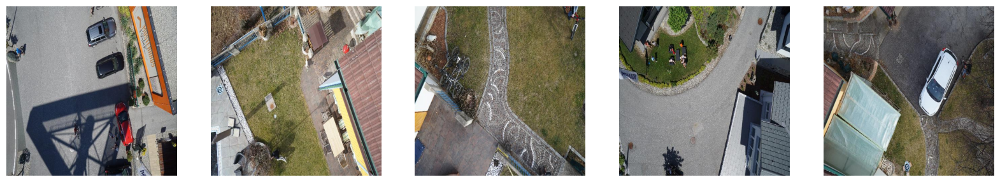

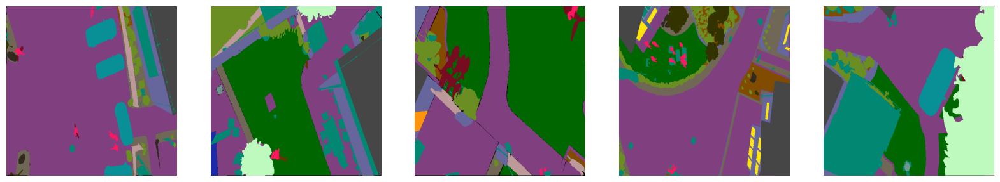

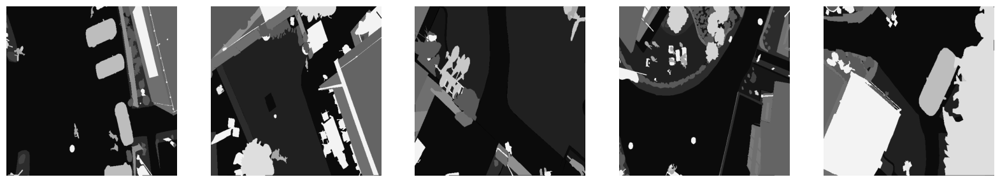

In [ ]:
# Display some sample images and labels directly from the original dataset
def display_samples(dataframe, column, num_samples=5, title="Samples"):
    list_len = []
    plt.figure(figsize=(20, 10))
    for i in range(num_samples):
        plt.subplot(1, num_samples, i+1)
        img = Image.open(dataframe[column][i])
        #print(np.array(img))
        list_len.append(len(np.unique(img)))
        plt.imshow(img, cmap="gray",  vmin=0, vmax=23)
        plt.axis('off')
    #plt.title(title)
    #print(max(list_len))
    plt.show()

# Display sample images
display_samples(df, 'image_path', title="Sample Images")
# Display sample RGB labels
display_samples(df, 'rgb_label_path', title="Sample RGB Labels")
# Display sample labels
display_samples(df, 'label_path', title="Sample Labels")

In [ ]:

# Create Dataset class
class DroneDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        image_path = self.df.iloc[idx, 0]
        label_path = self.df.iloc[idx, 1]

        image = Image.open(image_path)
        label = Image.open(label_path)

        if self.transform:
            image, label = self.transform(image, label)

        label = (1 + (label - label.min()) * (23 - 1) / (label.max() - label.min())).long()

        return image, label

In [ ]:
# Data augmentation class
class CombinedTransform:
    def __init__(self, augment=True, mean=None, std=None):
        self.augment = augment
        self.mean = mean
        self.std = std

    def __call__(self, image, mask):
        if self.augment:
            if random.random() > 0.5:
                image = TF.hflip(image)
                mask = TF.hflip(mask)
            if random.random() > 0.5:
                image = TF.vflip(image)
                mask = TF.vflip(mask)
            if random.random() > 0.5:
                angle = random.uniform(-30, 30)
                image = TF.rotate(image, angle, interpolation=TF.InterpolationMode.NEAREST)
                mask = TF.rotate(mask, angle, interpolation=TF.InterpolationMode.NEAREST)
            if random.random() > 0.5:
                image = TF.adjust_brightness(image, brightness_factor=random.uniform(0.7, 1.3))
            if random.random() > 0.5:
                image = TF.adjust_contrast(image, contrast_factor=random.uniform(0.7, 1.3))


        if not self.augment:
            image = TF.resize(image, (512, 512), interpolation=TF.InterpolationMode.NEAREST)
            mask = TF.resize(mask, (512, 512), interpolation=TF.InterpolationMode.NEAREST)

            image = TF.to_tensor(image).float()
            mask = TF.to_tensor(mask).float()

            if self.mean is not None and self.std is not None:
                image = TF.normalize(image, mean=self.mean, std=self.std)

            return image, mask

        image = TF.resize(image, (512, 512), interpolation=TF.InterpolationMode.NEAREST)
        mask = TF.resize(mask, (512, 512), interpolation=TF.InterpolationMode.NEAREST)

        image = TF.to_tensor(image).float()
        mask = TF.to_tensor(mask).float()

        if self.mean is not None and self.std is not None:
            image = TF.normalize(image, mean=self.mean, std=self.std)

        return image, mask

In [ ]:
# Compute mean and standard deviation on original dataset
def compute_mean_std(train_df, dataset_class, transform_class, batch_size=16):
    # Use the transformation without augmentation and normalization
    original_transform = transform_class(augment=False, mean=None, std=None)
    original_dataset = dataset_class(train_df, transform=original_transform)
    original_dataloader = DataLoader(original_dataset, batch_size=batch_size, shuffle=False)

    mean = torch.zeros(3)
    std = torch.zeros(3)
    n_samples = 0

    for images, _ in original_dataloader:
        images = images.float()  # Ensure the images are in float type
        batch_samples = images.size(0)  # batch size (the last batch can have smaller size)
        images = images.view(batch_samples, images.size(1), -1)
        mean += images.mean(2).sum(0)
        std += images.std(2).sum(0)
        n_samples += batch_samples
        break

    mean /= n_samples
    std /= n_samples

    return mean, std

In [ ]:
# Split the dataset dataframe into train, validation, and test sets
train_df, test_df = train_test_split(df, test_size=0.1)
train_df, val_df = train_test_split(train_df, test_size=0.1)
print("Train size:", len(train_df))
print("Validation size:", len(val_df))
print("Test size:", len(test_df))

# Compute mean and std
mean, std = compute_mean_std(train_df, DroneDataset, CombinedTransform)
print(f'Mean: {mean}, Std: {std}')

#Define the transformation with augmentation and normalization
train_transform = CombinedTransform(augment=True, mean=mean, std=std)
val_test_transform = CombinedTransform(augment=False, mean=mean, std=std)

# Create datasets
train_dataset = DroneDataset(train_df, transform=train_transform)
val_dataset = DroneDataset(val_df, transform=val_test_transform)
test_dataset = DroneDataset(test_df, transform=val_test_transform)

# Create dataloaders
batch_size = 4
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=False)

Train size: 324
Validation size: 36
Test size: 40
Mean: tensor([0.4647, 0.4490, 0.4141]), Std: tensor([0.2063, 0.2021, 0.2146])


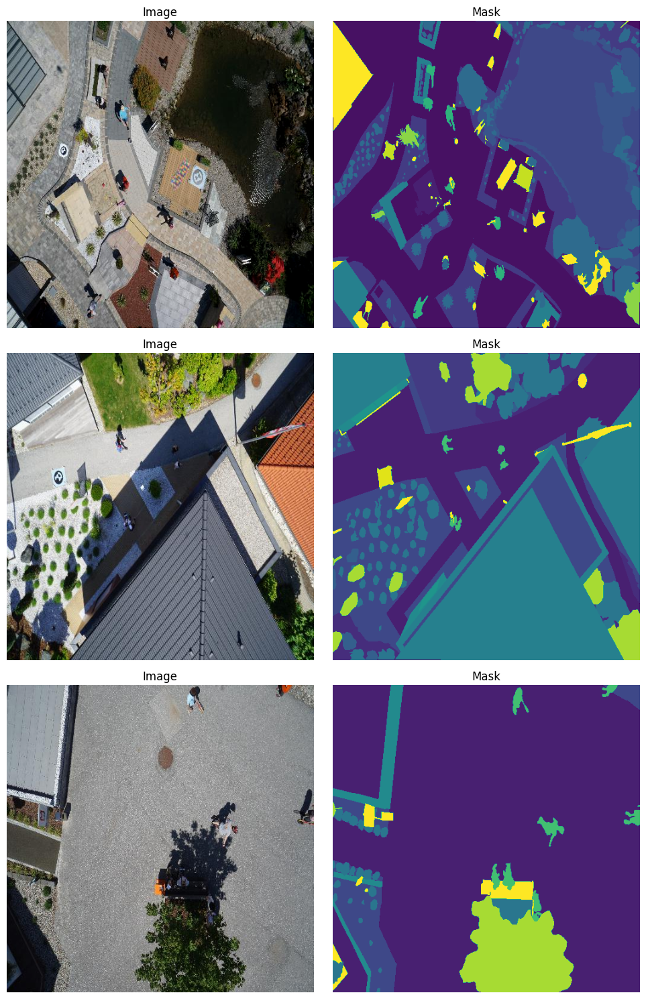

In [ ]:
def denormalize_image(image, mean, std):
    # Ensure mean and std are numpy arrays
    mean = np.array(mean)
    std = np.array(std)

    # Denormalize the image
    image = image * std + mean

    # Clip the image to the valid range [0, 255] and normalize to [0, 1] for display
    image = np.clip(image, 0, 1)

    return image

# Displays images from the da
def display_samples_from_dataloader(dataloader, num_samples=30, mean=None, std=None):
    # Retrieve a batch of data
    for images, masks in dataloader:

        # Select a subset of samples
        images = images[:num_samples]
        masks = masks[:num_samples]

        # Create a subplot
        fig, axs = plt.subplots(num_samples, 2, figsize=(10, num_samples * 5))

        for i in range(num_samples):
            # Convert tensor to numpy for visualization
            image = images[i].permute(1, 2, 0).numpy()
            mask = masks[i].permute(1, 2, 0).numpy()

            #print(max(np.unique(mask)))


            # Denormalize image if necessary
            if mean is not None and std is not None:
                image = denormalize_image(image, mean, std)

            # Display the image
            axs[i, 0].imshow(image)
            axs[i, 0].set_title("Image")
            axs[i, 0].axis('off')

            # Display the mask
            axs[i, 1].imshow(mask,  vmin=0, vmax=23)
            axs[i, 1].set_title("Mask")
            axs[i, 1].axis('off')

        plt.tight_layout()
        plt.show()
        break

display_samples_from_dataloader(train_dataloader, num_samples=3, mean=mean, std=std)

In [ ]:
class SimpleFCN(nn.Module):
    def __init__(self, num_classes):
        super(SimpleFCN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            #nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            #nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )

        self.classifier = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            #nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, num_classes, kernel_size=1),
            #nn.BatchNorm2d(num_classes),
            nn.Upsample(scale_factor=4, mode='bilinear', align_corners=True)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x

In [ ]:
class Trainer:
    def __init__(self, model, train_dataloader, val_dataloader, test_dataloader, lr, patience=20, num_classes=24):
        # Dataloaders
        self.train_dataloader = train_dataloader
        self.val_dataloader = val_dataloader
        self.test_dataloader = test_dataloader

        # Device, model, optimizer, criterion
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model = model.to(self.device)
        self.optimizer = optim.AdamW(self.model.parameters(), lr=lr)
        self.criterion = smp.losses.JaccardLoss(mode='multiclass')
        #self.criterion = nn.CrossEntropyLoss()

        # Early stopping
        self.patience = patience
        self.best_val_loss = float('inf')
        self.epochs_no_improve = 0
        self.num_classes = num_classes
        self.best_model_state = None

        # Store metrics for plotting
        self.epoch = 0
        self.train_losses = []
        self.val_losses = []
        self.pixel_accuracies = []
        self.mean_iou_scores = []
        self.class_iou_scores = []

        self.lr = lr

    def train(self, epochs):
        gc.collect()
        torch.cuda.empty_cache()

        for epoch in range(epochs):
            self.model.train()

            self.epoch += 1
            running_loss = 0

            for i, (images, labels) in tqdm(enumerate(self.train_dataloader), total=len(self.train_dataloader)):
                images = images.to(self.device)
                labels = labels.to(self.device).squeeze(1).long()

                self.optimizer.zero_grad()

                outputs = self.model(images)

                loss = self.criterion(outputs, labels)
                loss.backward()

                self.optimizer.step()

                running_loss += loss.item()

            # Append train loss
            self.train_losses.append(running_loss / len(self.train_dataloader))

            # Calculate validation loss and metrics
            val_loss, val_pixel_acc, val_mean_iou, class_iou = self.evaluate(self.val_dataloader)
            self.val_losses.append(val_loss)
            self.pixel_accuracies.append(val_pixel_acc)
            self.mean_iou_scores.append(val_mean_iou)
            self.class_iou_scores.append(class_iou)

            # Print metrics
            print(f"Epoch {self.epoch} - Train Loss: {self.train_losses[-1]}, Validation Loss: {val_loss}, "
                  f"Pixel-wise Accuracy: {val_pixel_acc}, Mean IoU: {val_mean_iou}")

            #if epoch % 15 == 0 and epoch != 0:
            #    self.plot_metrics(epoch+1)

            # Early stopping
            if val_loss < self.best_val_loss:
                self.best_val_loss = val_loss
                self.epochs_no_improve = 0
                self.best_model_state = self.model.state_dict()
            else:
                self.epochs_no_improve += 1
                print(f"Validation loss has not improved for {self.epochs_no_improve} epochs")
                if self.epochs_no_improve == self.patience:
                    print("Early stopping!")
                    break

        # Load best model state
        self.model.load_state_dict(self.best_model_state)
        self.plot_metrics()

    def evaluate(self, dataloader):
        self.model.eval()

        running_loss, total_correct_pixels, total_pixels = 0, 0, 0
        intersection = torch.zeros(self.num_classes)
        union = torch.zeros(self.num_classes)

        with torch.no_grad():
            for images, labels in dataloader:
                images = images.to(self.device)
                labels = labels.to(self.device).squeeze(1).long()

                outputs = self.model(images)
                loss = self.criterion(outputs, labels)
                running_loss += loss.item()

                # Calculate pixel-wise accuracy
                _, predicted = torch.max(outputs, 1)
                total_correct_pixels += (predicted == labels).sum().item()
                total_pixels += labels.numel()

                # Calculate IoU
                for cls in range(self.num_classes):
                    class_labels = (labels == cls)
                    class_preds = (predicted == cls)
                    intersection[cls] += torch.logical_and(class_labels, class_preds).sum().item()
                    union[cls] += torch.logical_or(class_labels, class_preds).sum().item()

        loss = running_loss / len(dataloader)
        pixel_accuracy = total_correct_pixels / total_pixels

        # Handle division by zero for IoU calculation
        union[union == 0] = 1
        class_iou = intersection / union
        mean_iou = torch.mean(class_iou).item()

        return loss, pixel_accuracy, mean_iou, class_iou

    def test(self):
        test_loss, test_pixel_acc, test_mean_iou, class_iou = self.evaluate(self.test_dataloader)

        print(f"Test Loss: {test_loss}")
        print(f"Pixel-wise Accuracy: {test_pixel_acc}")
        print(f"Mean IoU: {test_mean_iou}")
        for cls in range(self.num_classes):
            print(f"IoU for class {cls}: {class_iou[cls].item()}")
        return test_loss, test_pixel_acc, test_mean_iou, class_iou

    def plot_metrics(self):
        plt.figure(figsize=(12, 8))

        self.epoch += 1

        # Plot Loss
        plt.subplot(2, 2, 1)
        plt.plot(range(1, self.epoch), self.train_losses, label='Train Loss')
        plt.plot(range(1, self.epoch), self.val_losses, label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()

        # Plot Pixel-wise Accuracy
        plt.subplot(2, 2, 2)
        plt.plot(range(1, self.epoch), self.pixel_accuracies, label='Pixel-wise Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.title('Pixel-wise Accuracy')
        plt.legend()

        # Plot Mean IoU
        plt.subplot(2, 2, 3)
        plt.plot(range(1, self.epoch), self.mean_iou_scores, label='Mean IoU')
        plt.xlabel('Epoch')
        plt.ylabel('IoU')
        plt.title('Mean IoU')
        plt.legend()

        # Plot Class-wise IoU
        plt.subplot(2, 2, 4)
        class_iou_scores_np = torch.stack(self.class_iou_scores).numpy()
        for cls in range(self.num_classes):
            plt.plot(range(1, self.epoch), class_iou_scores_np[:, cls], label=f'Class {cls} IoU')
        plt.xlabel('Epoch')
        plt.ylabel('IoU')
        plt.title('Class-wise IoU')
        #plt.legend()

        plt.tight_layout()
        plt.show()

In [ ]:
# Models dictionaries
models = {
    'SimpleFCN': SimpleFCN(24), # Baseline
    'FPN': smp.FPN(encoder_name="efficientnet-b3", encoder_weights="imagenet", in_channels=3, classes=24), # Good performance
    'DeepLabV3Plus': smp.DeepLabV3Plus(encoder_name="efficientnet-b3", encoder_weights="imagenet", in_channels=3, classes=24) # Best performance
}

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b3-5fb5a3c3.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b3-5fb5a3c3.pth
100%|██████████| 47.1M/47.1M [00:01<00:00, 34.1MB/s]


Training SimpleFCN...


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 1 - Train Loss: 0.7599530175880149, Validation Loss: 0.7743479079670377, Pixel-wise Accuracy: 0.38294241163465714, Mean IoU: 0.04474686458706856


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 2 - Train Loss: 0.7304698272987649, Validation Loss: 0.7618558406829834, Pixel-wise Accuracy: 0.4538371827867296, Mean IoU: 0.05490592494606972


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 3 - Train Loss: 0.7242339529373027, Validation Loss: 0.7563911411497328, Pixel-wise Accuracy: 0.46288331349690753, Mean IoU: 0.06205345317721367


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 4 - Train Loss: 0.7211535642912359, Validation Loss: 0.7537721726629469, Pixel-wise Accuracy: 0.44267622629801434, Mean IoU: 0.06821490824222565


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 5 - Train Loss: 0.716990758607417, Validation Loss: 0.7509075403213501, Pixel-wise Accuracy: 0.4545827441745334, Mean IoU: 0.0695873275399208


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 6 - Train Loss: 0.7100351357165678, Validation Loss: 0.7460703121291267, Pixel-wise Accuracy: 0.4482542673746745, Mean IoU: 0.07508915662765503


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 7 - Train Loss: 0.7118951119022605, Validation Loss: 0.744803614086575, Pixel-wise Accuracy: 0.4605783886379666, Mean IoU: 0.07920848578214645


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 8 - Train Loss: 0.7050522521690086, Validation Loss: 0.7431880897945828, Pixel-wise Accuracy: 0.4456203248765733, Mean IoU: 0.08167456835508347


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 9 - Train Loss: 0.7038257357514934, Validation Loss: 0.7384466197755601, Pixel-wise Accuracy: 0.45462491777208114, Mean IoU: 0.08692219108343124


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 10 - Train Loss: 0.6886982314380599, Validation Loss: 0.7379089991251627, Pixel-wise Accuracy: 0.47836875915527344, Mean IoU: 0.08761543780565262


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 11 - Train Loss: 0.7038305872752343, Validation Loss: 0.7398990127775404, Pixel-wise Accuracy: 0.45947657691107857, Mean IoU: 0.08624828606843948
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 12 - Train Loss: 0.6999631590313382, Validation Loss: 0.7319437166055044, Pixel-wise Accuracy: 0.4970587624443902, Mean IoU: 0.09354361891746521


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 13 - Train Loss: 0.6960447290797293, Validation Loss: 0.7319217920303345, Pixel-wise Accuracy: 0.4830926259358724, Mean IoU: 0.09637214988470078


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 14 - Train Loss: 0.6906752512778764, Validation Loss: 0.7313442925612131, Pixel-wise Accuracy: 0.49033663007948136, Mean IoU: 0.09777753800153732


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 15 - Train Loss: 0.6905688341752982, Validation Loss: 0.7278541028499603, Pixel-wise Accuracy: 0.5017157660590278, Mean IoU: 0.10258391499519348


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 16 - Train Loss: 0.6872150342405579, Validation Loss: 0.7261010871993171, Pixel-wise Accuracy: 0.4946155548095703, Mean IoU: 0.10092488676309586


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 17 - Train Loss: 0.67174740926719, Validation Loss: 0.7306500011020236, Pixel-wise Accuracy: 0.47277916802300346, Mean IoU: 0.10232215374708176
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 18 - Train Loss: 0.6789965611181141, Validation Loss: 0.724003298415078, Pixel-wise Accuracy: 0.5012602276272244, Mean IoU: 0.10488542169332504


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 19 - Train Loss: 0.692018958521478, Validation Loss: 0.7237587538030412, Pixel-wise Accuracy: 0.49971654680040145, Mean IoU: 0.10677222162485123


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 20 - Train Loss: 0.676153536931968, Validation Loss: 0.7225461337301466, Pixel-wise Accuracy: 0.5103594462076823, Mean IoU: 0.1102701798081398


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 21 - Train Loss: 0.6816044574902381, Validation Loss: 0.7226005925072564, Pixel-wise Accuracy: 0.5018293592664931, Mean IoU: 0.10850317031145096
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 22 - Train Loss: 0.679269673647704, Validation Loss: 0.7218009233474731, Pixel-wise Accuracy: 0.4967275195651584, Mean IoU: 0.1102452352643013


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 23 - Train Loss: 0.6785065642109623, Validation Loss: 0.7204531166288588, Pixel-wise Accuracy: 0.4940481185913086, Mean IoU: 0.11067972332239151


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 24 - Train Loss: 0.6702271155369135, Validation Loss: 0.7197937203778161, Pixel-wise Accuracy: 0.5059764650132921, Mean IoU: 0.1103869080543518


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 25 - Train Loss: 0.6802522760850412, Validation Loss: 0.7226118942101797, Pixel-wise Accuracy: 0.4966822730170356, Mean IoU: 0.10819325596094131
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 26 - Train Loss: 0.679628019347603, Validation Loss: 0.7229489684104919, Pixel-wise Accuracy: 0.4928346210055881, Mean IoU: 0.107933908700943
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 27 - Train Loss: 0.6739357124876093, Validation Loss: 0.7204695112175412, Pixel-wise Accuracy: 0.49697717030843097, Mean IoU: 0.11093541234731674
Validation loss has not improved for 3 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 28 - Train Loss: 0.6795716613163183, Validation Loss: 0.7190392745865716, Pixel-wise Accuracy: 0.5067355897691515, Mean IoU: 0.10949474573135376


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 29 - Train Loss: 0.6734972721264686, Validation Loss: 0.7175566918320126, Pixel-wise Accuracy: 0.5118580924140083, Mean IoU: 0.1152312159538269


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 30 - Train Loss: 0.6642569207850798, Validation Loss: 0.7187976737817129, Pixel-wise Accuracy: 0.5048941506279839, Mean IoU: 0.11382949352264404
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 31 - Train Loss: 0.6721621185173223, Validation Loss: 0.7154593037234412, Pixel-wise Accuracy: 0.5179044935438368, Mean IoU: 0.11484205722808838


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 32 - Train Loss: 0.6747846831510096, Validation Loss: 0.7190354863802592, Pixel-wise Accuracy: 0.5189680523342557, Mean IoU: 0.11000647395849228
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 33 - Train Loss: 0.668422125003956, Validation Loss: 0.718006087674035, Pixel-wise Accuracy: 0.5086799197726779, Mean IoU: 0.10952334851026535
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 34 - Train Loss: 0.6584428478906184, Validation Loss: 0.7174978587362502, Pixel-wise Accuracy: 0.4948475095960829, Mean IoU: 0.11202792078256607
Validation loss has not improved for 3 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 35 - Train Loss: 0.6623954717759732, Validation Loss: 0.7156608170933194, Pixel-wise Accuracy: 0.5076938205295138, Mean IoU: 0.11469081044197083
Validation loss has not improved for 4 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 36 - Train Loss: 0.6765474106794522, Validation Loss: 0.7146458327770233, Pixel-wise Accuracy: 0.5081299675835503, Mean IoU: 0.11533165723085403


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 37 - Train Loss: 0.6724424211331356, Validation Loss: 0.7150233255492316, Pixel-wise Accuracy: 0.5151658587985568, Mean IoU: 0.11666173487901688
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 38 - Train Loss: 0.6622975884396353, Validation Loss: 0.71423715684149, Pixel-wise Accuracy: 0.5105582343207465, Mean IoU: 0.11597580462694168


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 39 - Train Loss: 0.6621735898064979, Validation Loss: 0.7159931626584795, Pixel-wise Accuracy: 0.504277229309082, Mean IoU: 0.11554551869630814
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 40 - Train Loss: 0.6583417208842289, Validation Loss: 0.7147795425521003, Pixel-wise Accuracy: 0.5086656146579318, Mean IoU: 0.11774610728025436
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 41 - Train Loss: 0.6628459625773959, Validation Loss: 0.7146412432193756, Pixel-wise Accuracy: 0.5032650629679362, Mean IoU: 0.11714018136262894
Validation loss has not improved for 3 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 42 - Train Loss: 0.6783312305256173, Validation Loss: 0.7168113456832038, Pixel-wise Accuracy: 0.4855910407172309, Mean IoU: 0.1131758987903595
Validation loss has not improved for 4 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 43 - Train Loss: 0.6615701648924086, Validation Loss: 0.713905629184511, Pixel-wise Accuracy: 0.5063902537027994, Mean IoU: 0.11482495069503784


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 44 - Train Loss: 0.6635658100799278, Validation Loss: 0.7137872841623094, Pixel-wise Accuracy: 0.5049057006835938, Mean IoU: 0.11798311024904251


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 45 - Train Loss: 0.6661890815069647, Validation Loss: 0.710854967435201, Pixel-wise Accuracy: 0.5094140370686849, Mean IoU: 0.1202734187245369


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 46 - Train Loss: 0.6578280498952042, Validation Loss: 0.7148834963639578, Pixel-wise Accuracy: 0.511765374077691, Mean IoU: 0.11506211757659912
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 47 - Train Loss: 0.6585252873691512, Validation Loss: 0.7125013205740187, Pixel-wise Accuracy: 0.5097221798366971, Mean IoU: 0.1175001934170723
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 48 - Train Loss: 0.6559677631766708, Validation Loss: 0.7112507389651405, Pixel-wise Accuracy: 0.5095350477430556, Mean IoU: 0.11876728385686874
Validation loss has not improved for 3 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 49 - Train Loss: 0.661544735049024, Validation Loss: 0.7132697337203555, Pixel-wise Accuracy: 0.5139430363972982, Mean IoU: 0.11437200754880905
Validation loss has not improved for 4 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 50 - Train Loss: 0.6650663312570548, Validation Loss: 0.7111583683225844, Pixel-wise Accuracy: 0.520287831624349, Mean IoU: 0.11907974630594254
Validation loss has not improved for 5 epochs
Early stopping!


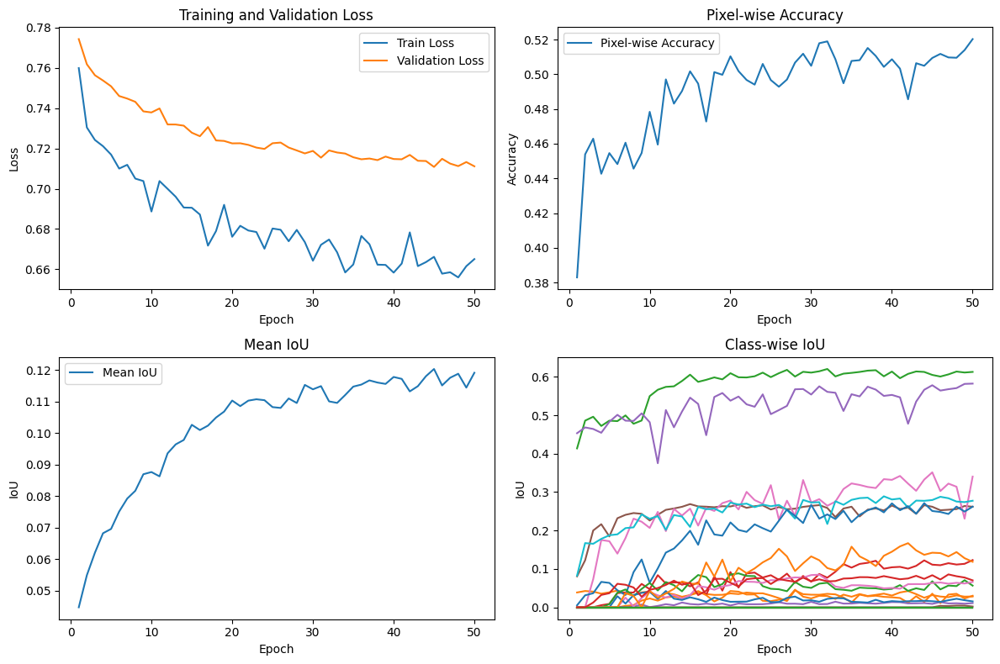

Saving SimpleFCN best model as 'SimpleFCN_best_model.pth'...
Testing SimpleFCN on test-set...
Test Loss: 0.41596507281064987
Pixel-wise Accuracy: 0.48274030685424807
Mean IoU: 0.110887311398983
IoU for class 0: 0.0
IoU for class 1: 0.0036670330446213484
IoU for class 2: 0.4853920042514801
IoU for class 3: 0.21714098751544952
IoU for class 4: 0.5819755792617798
IoU for class 5: 0.30531346797943115
IoU for class 6: 0.09976262599229813
IoU for class 7: 0.0
IoU for class 8: 0.0
IoU for class 9: 0.25449907779693604
IoU for class 10: 0.2596450448036194
IoU for class 11: 0.09227803349494934
IoU for class 12: 0.01041592750698328
IoU for class 13: 0.0
IoU for class 14: 0.036339171230793
IoU for class 15: 0.0012079726438969374
IoU for class 16: 0.08547983318567276
IoU for class 17: 0.0
IoU for class 18: 0.0
IoU for class 19: 0.0
IoU for class 20: 0.020521728321909904
IoU for class 21: 0.08232032507658005
IoU for class 22: 0.0
IoU for class 23: 0.12533673644065857
Training FPN...


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 1 - Train Loss: 0.7214413182235059, Validation Loss: 0.6792291071679857, Pixel-wise Accuracy: 0.5723624759250217, Mean IoU: 0.17747972905635834


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 2 - Train Loss: 0.5984067456957735, Validation Loss: 0.643170071972741, Pixel-wise Accuracy: 0.6110104454888238, Mean IoU: 0.22214989364147186


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 3 - Train Loss: 0.5590953160951166, Validation Loss: 0.6103601720598009, Pixel-wise Accuracy: 0.6460408104790581, Mean IoU: 0.262355238199234


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 4 - Train Loss: 0.541979506795789, Validation Loss: 0.5941941506332822, Pixel-wise Accuracy: 0.6553839577568902, Mean IoU: 0.27532628178596497


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 5 - Train Loss: 0.5180198197011594, Validation Loss: 0.5832352903154161, Pixel-wise Accuracy: 0.6605696148342557, Mean IoU: 0.28597894310951233


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 6 - Train Loss: 0.5172293432700781, Validation Loss: 0.5663632022009956, Pixel-wise Accuracy: 0.6669584910074869, Mean IoU: 0.3085135519504547


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 7 - Train Loss: 0.5017096047048215, Validation Loss: 0.5556857718361748, Pixel-wise Accuracy: 0.6766785515679253, Mean IoU: 0.32732096314430237


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 8 - Train Loss: 0.49079621500439113, Validation Loss: 0.5434089203675588, Pixel-wise Accuracy: 0.6742507086859809, Mean IoU: 0.3377567231655121


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 9 - Train Loss: 0.4846959654931669, Validation Loss: 0.5323663420147366, Pixel-wise Accuracy: 0.6877409617106119, Mean IoU: 0.3474520146846771


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 10 - Train Loss: 0.46942492694030574, Validation Loss: 0.5309126012855105, Pixel-wise Accuracy: 0.6847097608778212, Mean IoU: 0.3473215103149414


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 11 - Train Loss: 0.4747398153499321, Validation Loss: 0.5268962416383955, Pixel-wise Accuracy: 0.687660641140408, Mean IoU: 0.3499421179294586


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 12 - Train Loss: 0.45449110681628, Validation Loss: 0.5256123145421346, Pixel-wise Accuracy: 0.6891400019327799, Mean IoU: 0.3516331911087036


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 13 - Train Loss: 0.4452995565938361, Validation Loss: 0.5186016824510362, Pixel-wise Accuracy: 0.6940692265828451, Mean IoU: 0.3619067668914795


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 14 - Train Loss: 0.45229864046897417, Validation Loss: 0.5182473262151083, Pixel-wise Accuracy: 0.6937558915879991, Mean IoU: 0.3584947884082794


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 15 - Train Loss: 0.4470417985209712, Validation Loss: 0.5127407411734263, Pixel-wise Accuracy: 0.6973623699612088, Mean IoU: 0.36301347613334656


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 16 - Train Loss: 0.43533451505649234, Validation Loss: 0.511101676358117, Pixel-wise Accuracy: 0.695489247639974, Mean IoU: 0.36464980244636536


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 17 - Train Loss: 0.42631934196860705, Validation Loss: 0.509984380669064, Pixel-wise Accuracy: 0.6976967917548286, Mean IoU: 0.3676103353500366


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 18 - Train Loss: 0.4207658070473023, Validation Loss: 0.508225291967392, Pixel-wise Accuracy: 0.7034148110283746, Mean IoU: 0.3663513660430908


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 19 - Train Loss: 0.42815941884929754, Validation Loss: 0.5040005975299411, Pixel-wise Accuracy: 0.702106793721517, Mean IoU: 0.3745373785495758


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 20 - Train Loss: 0.4295870577111656, Validation Loss: 0.506620917055342, Pixel-wise Accuracy: 0.6999430126614041, Mean IoU: 0.3717237710952759
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 21 - Train Loss: 0.4180479472802009, Validation Loss: 0.5041513807243772, Pixel-wise Accuracy: 0.7024512820773654, Mean IoU: 0.37427011132240295
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 22 - Train Loss: 0.40596989165117714, Validation Loss: 0.5032350321610769, Pixel-wise Accuracy: 0.6990041732788086, Mean IoU: 0.37421295046806335


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 23 - Train Loss: 0.42163600082750674, Validation Loss: 0.5024428930547502, Pixel-wise Accuracy: 0.7018587324354384, Mean IoU: 0.37266671657562256


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 24 - Train Loss: 0.4132774755542661, Validation Loss: 0.5031798746850755, Pixel-wise Accuracy: 0.7024465137057834, Mean IoU: 0.3740755021572113
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 25 - Train Loss: 0.4091669265870695, Validation Loss: 0.5001306931177775, Pixel-wise Accuracy: 0.7037669287787544, Mean IoU: 0.378374308347702


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 26 - Train Loss: 0.4184853559658851, Validation Loss: 0.49889008204142254, Pixel-wise Accuracy: 0.7036457061767578, Mean IoU: 0.37711918354034424


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 27 - Train Loss: 0.4170746545732757, Validation Loss: 0.5004847149054209, Pixel-wise Accuracy: 0.7045354843139648, Mean IoU: 0.3750680983066559
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 28 - Train Loss: 0.3916230974373994, Validation Loss: 0.4986829294098748, Pixel-wise Accuracy: 0.7046724955240885, Mean IoU: 0.3800598680973053


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 29 - Train Loss: 0.40083718962139553, Validation Loss: 0.4961900810400645, Pixel-wise Accuracy: 0.7078577677408854, Mean IoU: 0.3816399872303009


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 30 - Train Loss: 0.4014226367444168, Validation Loss: 0.4967244201236301, Pixel-wise Accuracy: 0.704888661702474, Mean IoU: 0.3806804418563843
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 31 - Train Loss: 0.3927581523671562, Validation Loss: 0.4955497483412425, Pixel-wise Accuracy: 0.7071783277723525, Mean IoU: 0.3798539638519287


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 32 - Train Loss: 0.3932699413947117, Validation Loss: 0.4936287999153137, Pixel-wise Accuracy: 0.7085464265611436, Mean IoU: 0.3835793435573578


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 33 - Train Loss: 0.39618412911156076, Validation Loss: 0.49560894237624276, Pixel-wise Accuracy: 0.7077362272474501, Mean IoU: 0.38255468010902405
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 34 - Train Loss: 0.40115300519966784, Validation Loss: 0.4916885760095384, Pixel-wise Accuracy: 0.7101185056898329, Mean IoU: 0.38509058952331543


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 35 - Train Loss: 0.38640405550415136, Validation Loss: 0.4901239640182919, Pixel-wise Accuracy: 0.7095769246419271, Mean IoU: 0.38561907410621643


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 36 - Train Loss: 0.39232412974039715, Validation Loss: 0.49084290530946517, Pixel-wise Accuracy: 0.7101044125027127, Mean IoU: 0.3856140077114105
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 37 - Train Loss: 0.38352247723090793, Validation Loss: 0.48694606290923226, Pixel-wise Accuracy: 0.7106313705444336, Mean IoU: 0.3884407579898834


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 38 - Train Loss: 0.39349485216317354, Validation Loss: 0.48928582006030613, Pixel-wise Accuracy: 0.7098062303331163, Mean IoU: 0.38605812191963196
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 39 - Train Loss: 0.3728927487944379, Validation Loss: 0.48823364410135484, Pixel-wise Accuracy: 0.7096967697143555, Mean IoU: 0.3898893892765045
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 40 - Train Loss: 0.3875634158834999, Validation Loss: 0.48690003487798905, Pixel-wise Accuracy: 0.7124929428100586, Mean IoU: 0.38925203680992126


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 41 - Train Loss: 0.3764634689799062, Validation Loss: 0.48728694518407184, Pixel-wise Accuracy: 0.713769170973036, Mean IoU: 0.3879100978374481
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 42 - Train Loss: 0.3827313252805192, Validation Loss: 0.48570076955689323, Pixel-wise Accuracy: 0.7143685022989908, Mean IoU: 0.3893609046936035


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 43 - Train Loss: 0.3878265847394496, Validation Loss: 0.4869910743501451, Pixel-wise Accuracy: 0.7137885623508029, Mean IoU: 0.3898482322692871
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 44 - Train Loss: 0.37891725165608486, Validation Loss: 0.4868190652794308, Pixel-wise Accuracy: 0.7129568523830838, Mean IoU: 0.39048850536346436
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 45 - Train Loss: 0.37867309355441436, Validation Loss: 0.48522178994284737, Pixel-wise Accuracy: 0.713070445590549, Mean IoU: 0.3928234577178955


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 46 - Train Loss: 0.3659599353501826, Validation Loss: 0.4827319648530748, Pixel-wise Accuracy: 0.7255896462334527, Mean IoU: 0.3951955735683441


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 47 - Train Loss: 0.3771568205621507, Validation Loss: 0.4802618357870314, Pixel-wise Accuracy: 0.7151741451687283, Mean IoU: 0.3957251310348511


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 48 - Train Loss: 0.3696293773842447, Validation Loss: 0.4809919165240394, Pixel-wise Accuracy: 0.7144211663140191, Mean IoU: 0.3941274583339691
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 49 - Train Loss: 0.3599702403133298, Validation Loss: 0.4759414295355479, Pixel-wise Accuracy: 0.7383074230617948, Mean IoU: 0.40183237195014954


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 50 - Train Loss: 0.36997763996506916, Validation Loss: 0.47725165883700055, Pixel-wise Accuracy: 0.7367307874891493, Mean IoU: 0.40030422806739807
Validation loss has not improved for 1 epochs


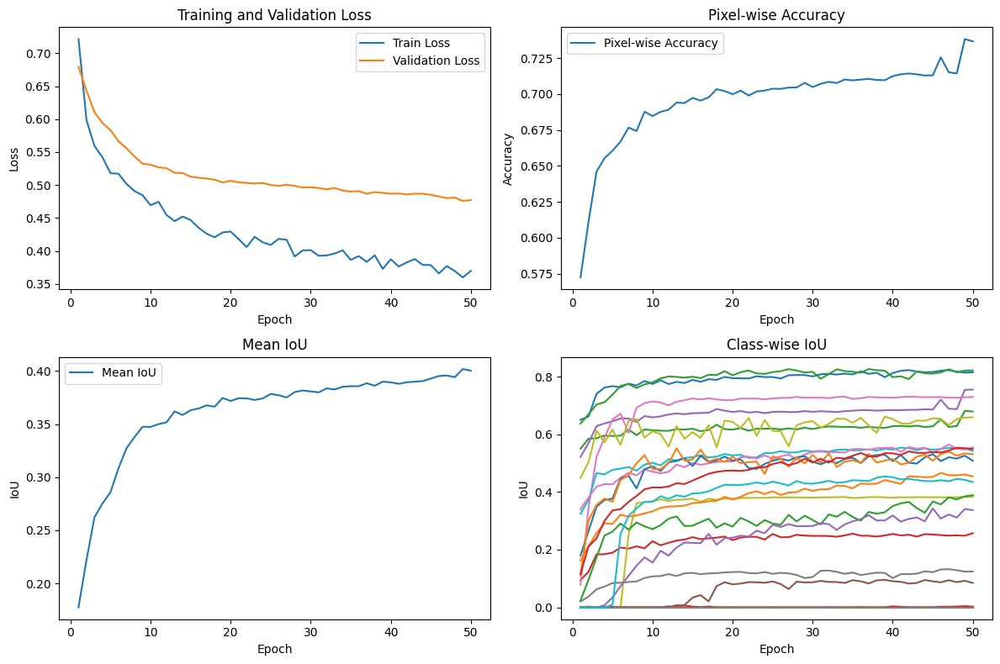

Saving FPN best model as 'FPN_best_model.pth'...
Testing FPN on test-set...
Test Loss: 0.315160877071321
Pixel-wise Accuracy: 0.6524613380432129
Mean IoU: 0.3529715836048126
IoU for class 0: 0.0
IoU for class 1: 0.0005323975346982479
IoU for class 2: 0.5624141097068787
IoU for class 3: 0.27906566858291626
IoU for class 4: 0.725273609161377
IoU for class 5: 0.0
IoU for class 6: 0.5239891409873962
IoU for class 7: 0.21702434122562408
IoU for class 8: 0.08042500168085098
IoU for class 9: 0.4664873480796814
IoU for class 10: 0.5729379653930664
IoU for class 11: 0.4144565165042877
IoU for class 12: 0.5761046409606934
IoU for class 13: 0.017244622111320496
IoU for class 14: 0.45462119579315186
IoU for class 15: 0.06564145535230637
IoU for class 16: 0.6165822148323059
IoU for class 17: 0.0
IoU for class 18: 0.7097843885421753
IoU for class 19: 0.13699942827224731
IoU for class 20: 0.6604045629501343
IoU for class 21: 0.4038499593734741
IoU for class 22: 0.5146884322166443
IoU for class 23: 0.

  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 1 - Train Loss: 0.7597978107723189, Validation Loss: 0.7565656767951118, Pixel-wise Accuracy: 0.4584537082248264, Mean IoU: 0.07507649064064026


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 2 - Train Loss: 0.7077588461063526, Validation Loss: 0.7199083434210883, Pixel-wise Accuracy: 0.5827328364054362, Mean IoU: 0.1212821900844574


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 3 - Train Loss: 0.6734358793423499, Validation Loss: 0.6957993706067404, Pixel-wise Accuracy: 0.5987958908081055, Mean IoU: 0.13832581043243408


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 4 - Train Loss: 0.6474157913967415, Validation Loss: 0.6747147176000807, Pixel-wise Accuracy: 0.6333921220567491, Mean IoU: 0.19255082309246063


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 5 - Train Loss: 0.619435997656834, Validation Loss: 0.6427711248397827, Pixel-wise Accuracy: 0.6746692657470703, Mean IoU: 0.21981996297836304


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 6 - Train Loss: 0.5924493799239029, Validation Loss: 0.618144240644243, Pixel-wise Accuracy: 0.6922059588962131, Mean IoU: 0.2584233582019806


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 7 - Train Loss: 0.5619202454884847, Validation Loss: 0.6087471048037211, Pixel-wise Accuracy: 0.6697556177775065, Mean IoU: 0.2695820927619934


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 8 - Train Loss: 0.5409641589647458, Validation Loss: 0.5891336500644684, Pixel-wise Accuracy: 0.7068163553873698, Mean IoU: 0.2951757609844208


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 9 - Train Loss: 0.5281884434782429, Validation Loss: 0.5708931916289859, Pixel-wise Accuracy: 0.7246162626478407, Mean IoU: 0.3184053897857666


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 10 - Train Loss: 0.5166284143924713, Validation Loss: 0.5628342992729611, Pixel-wise Accuracy: 0.7306973139444987, Mean IoU: 0.32586532831192017


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 11 - Train Loss: 0.4951430978598418, Validation Loss: 0.5559461116790771, Pixel-wise Accuracy: 0.7336299684312608, Mean IoU: 0.3273129165172577


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 12 - Train Loss: 0.48394441898958185, Validation Loss: 0.5516631172762977, Pixel-wise Accuracy: 0.7156254450480143, Mean IoU: 0.336013525724411


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 13 - Train Loss: 0.48605121580170996, Validation Loss: 0.5452700422869788, Pixel-wise Accuracy: 0.7160217497083876, Mean IoU: 0.34455880522727966


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 14 - Train Loss: 0.4597097738289539, Validation Loss: 0.5334242781003317, Pixel-wise Accuracy: 0.7175544102986654, Mean IoU: 0.35793164372444153


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 15 - Train Loss: 0.46746714174011605, Validation Loss: 0.52980085545116, Pixel-wise Accuracy: 0.7193072636922201, Mean IoU: 0.35612133145332336


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 16 - Train Loss: 0.4481084107616801, Validation Loss: 0.5205240613884397, Pixel-wise Accuracy: 0.7498445510864258, Mean IoU: 0.3708438575267792


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 17 - Train Loss: 0.4251654390935545, Validation Loss: 0.5232773953013949, Pixel-wise Accuracy: 0.7253763410780165, Mean IoU: 0.3657611608505249
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 18 - Train Loss: 0.4325067268477546, Validation Loss: 0.5117798977428012, Pixel-wise Accuracy: 0.754391246371799, Mean IoU: 0.3777894675731659


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 19 - Train Loss: 0.43772301151428694, Validation Loss: 0.513543556133906, Pixel-wise Accuracy: 0.7525977028740777, Mean IoU: 0.3777863085269928
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 20 - Train Loss: 0.4270767896999548, Validation Loss: 0.5133401354153951, Pixel-wise Accuracy: 0.7323786417643229, Mean IoU: 0.37310364842414856
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 21 - Train Loss: 0.43613253184306766, Validation Loss: 0.5048722790347205, Pixel-wise Accuracy: 0.7574754291110568, Mean IoU: 0.3812832832336426


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 22 - Train Loss: 0.4190155271394753, Validation Loss: 0.5121374130249023, Pixel-wise Accuracy: 0.7318717108832465, Mean IoU: 0.3741455078125
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 23 - Train Loss: 0.4135334285688989, Validation Loss: 0.5021380848354764, Pixel-wise Accuracy: 0.7586565017700195, Mean IoU: 0.3806298077106476


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 24 - Train Loss: 0.40440793868936137, Validation Loss: 0.5057016213734945, Pixel-wise Accuracy: 0.7335151036580404, Mean IoU: 0.3806305229663849
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 25 - Train Loss: 0.42406965920954576, Validation Loss: 0.4984293116463555, Pixel-wise Accuracy: 0.7639348771837022, Mean IoU: 0.39107227325439453


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 26 - Train Loss: 0.4027570119978469, Validation Loss: 0.49788619412316215, Pixel-wise Accuracy: 0.7384231355455186, Mean IoU: 0.3854173719882965


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 27 - Train Loss: 0.4123083864465172, Validation Loss: 0.49666741987069446, Pixel-wise Accuracy: 0.7363816367255317, Mean IoU: 0.3857221305370331


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 28 - Train Loss: 0.39934387931853166, Validation Loss: 0.4930730726983812, Pixel-wise Accuracy: 0.7413792080349393, Mean IoU: 0.3947298526763916


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 29 - Train Loss: 0.4055817095953741, Validation Loss: 0.4874877333641052, Pixel-wise Accuracy: 0.7650189929538302, Mean IoU: 0.3981074392795563


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 30 - Train Loss: 0.38853971660137177, Validation Loss: 0.48982305659188163, Pixel-wise Accuracy: 0.7472594579060873, Mean IoU: 0.3921527862548828
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 31 - Train Loss: 0.3926664646025057, Validation Loss: 0.4885953731007046, Pixel-wise Accuracy: 0.7402560975816515, Mean IoU: 0.39247193932533264
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 32 - Train Loss: 0.3877759877546334, Validation Loss: 0.48367007904582554, Pixel-wise Accuracy: 0.7437495125664605, Mean IoU: 0.3978883922100067


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 33 - Train Loss: 0.3798534487500603, Validation Loss: 0.4795606765482161, Pixel-wise Accuracy: 0.7483343548244901, Mean IoU: 0.40135622024536133


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 34 - Train Loss: 0.38213599813573157, Validation Loss: 0.48263290855619645, Pixel-wise Accuracy: 0.7425302929348416, Mean IoU: 0.3993260860443115
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 35 - Train Loss: 0.3863900011336362, Validation Loss: 0.48147134317292106, Pixel-wise Accuracy: 0.744264178805881, Mean IoU: 0.4052658975124359
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 36 - Train Loss: 0.38144646290643713, Validation Loss: 0.47786837816238403, Pixel-wise Accuracy: 0.7420978546142578, Mean IoU: 0.4020589590072632


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 37 - Train Loss: 0.37181454013895104, Validation Loss: 0.4758823298745685, Pixel-wise Accuracy: 0.7550593482123481, Mean IoU: 0.4068893492221832


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 38 - Train Loss: 0.37326956383975934, Validation Loss: 0.4724320007695092, Pixel-wise Accuracy: 0.7691132227579752, Mean IoU: 0.4128430187702179


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 39 - Train Loss: 0.380232079161538, Validation Loss: 0.474049159222179, Pixel-wise Accuracy: 0.7710323333740234, Mean IoU: 0.4046576917171478
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 40 - Train Loss: 0.3698859420823462, Validation Loss: 0.4716356231106652, Pixel-wise Accuracy: 0.769336912367079, Mean IoU: 0.4089900553226471


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 41 - Train Loss: 0.3579691826929281, Validation Loss: 0.4665061831474304, Pixel-wise Accuracy: 0.7743358612060547, Mean IoU: 0.4121762216091156


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 42 - Train Loss: 0.3710311393678924, Validation Loss: 0.4617164482673009, Pixel-wise Accuracy: 0.7744306988186307, Mean IoU: 0.41527172923088074


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 43 - Train Loss: 0.3678903765516517, Validation Loss: 0.46537458731068504, Pixel-wise Accuracy: 0.7730569839477539, Mean IoU: 0.41334542632102966
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 44 - Train Loss: 0.3558198384664677, Validation Loss: 0.4669051302803887, Pixel-wise Accuracy: 0.7743183771769205, Mean IoU: 0.40882837772369385
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 45 - Train Loss: 0.3513877965785839, Validation Loss: 0.46077025598949856, Pixel-wise Accuracy: 0.7741866641574435, Mean IoU: 0.4165428876876831


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 46 - Train Loss: 0.359741457634502, Validation Loss: 0.4648946887916989, Pixel-wise Accuracy: 0.7741350597805448, Mean IoU: 0.4130772650241852
Validation loss has not improved for 1 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 47 - Train Loss: 0.35047610968719295, Validation Loss: 0.4665912505653169, Pixel-wise Accuracy: 0.7738666534423828, Mean IoU: 0.40598222613334656
Validation loss has not improved for 2 epochs


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 48 - Train Loss: 0.36885069531423076, Validation Loss: 0.4604038993517558, Pixel-wise Accuracy: 0.7751515706380209, Mean IoU: 0.41455087065696716


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 49 - Train Loss: 0.3478588447158719, Validation Loss: 0.45553655756844413, Pixel-wise Accuracy: 0.7764446470472548, Mean IoU: 0.4214892089366913


  0%|          | 0/81 [00:00<?, ?it/s]

Epoch 50 - Train Loss: 0.3605194687843323, Validation Loss: 0.460610063539611, Pixel-wise Accuracy: 0.7774997287326388, Mean IoU: 0.41880449652671814
Validation loss has not improved for 1 epochs


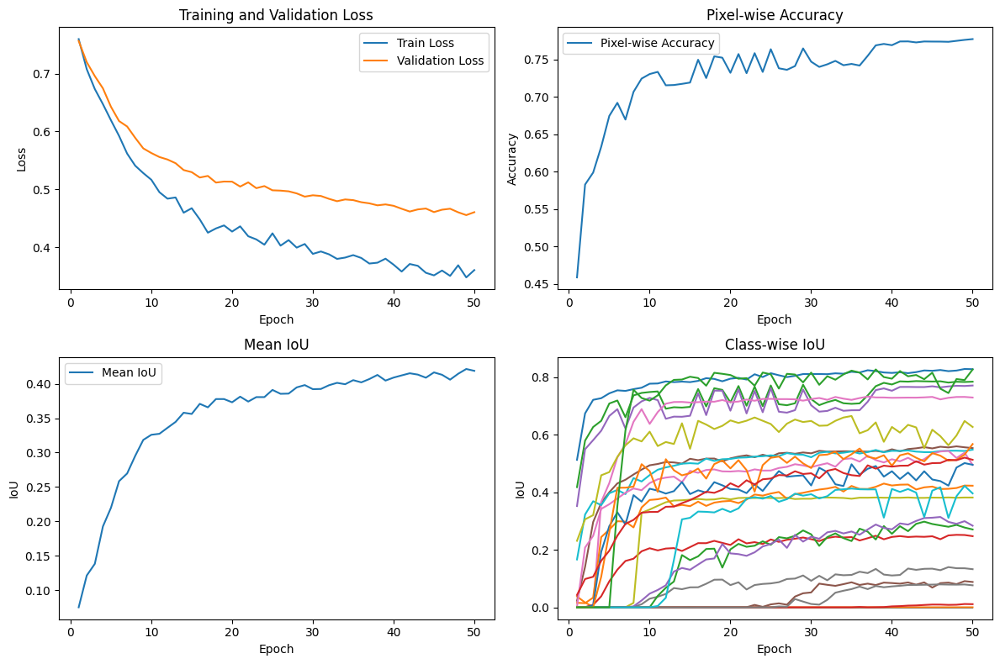

Saving DeepLabV3Plus best model as 'DeepLabV3Plus_best_model.pth'...
Testing DeepLabV3Plus on test-set...
Test Loss: 0.3080637937411666
Pixel-wise Accuracy: 0.6865838050842286
Mean IoU: 0.3674161434173584
IoU for class 0: 0.0
IoU for class 1: 0.00017366545216646045
IoU for class 2: 0.6376281380653381
IoU for class 3: 0.2638714015483856
IoU for class 4: 0.6888704895973206
IoU for class 5: 0.5480769872665405
IoU for class 6: 0.5236281156539917
IoU for class 7: 0.22975225746631622
IoU for class 8: 0.08071497827768326
IoU for class 9: 0.46361878514289856
IoU for class 10: 0.563302218914032
IoU for class 11: 0.40045487880706787
IoU for class 12: 0.5402497053146362
IoU for class 13: 0.0019751775544136763
IoU for class 14: 0.40016046166419983
IoU for class 15: 0.04606231674551964
IoU for class 16: 0.5610651969909668
IoU for class 17: 0.01058683730661869
IoU for class 18: 0.6975857615470886
IoU for class 19: 0.16824966669082642
IoU for class 20: 0.6544113159179688
IoU for class 21: 0.385737895

In [ ]:
# Clear cache and collect garbage
torch.cuda.empty_cache()
gc.collect()

# Dictionary to store the results
model_results = {}

# Training loop for each model
for model_name, model in models.items():
    print(f"Training {model_name}...")

    # If using DataParallel use all the available GPUs
    model = nn.DataParallel(model)
    model.to(torch.device("cuda" if torch.cuda.is_available() else "cpu"))

    epochs = 50
    lr = 0.0001
    patience = 5

    trainer = Trainer(model, train_dataloader, val_dataloader, test_dataloader, lr=lr, patience=patience)
    trainer.train(epochs)

    # Save the best model
    print(f"Saving {model_name} best model as '{model_name}_best_model.pth'...")
    torch.save(trainer.best_model_state, f"{model_name}_best_model.pth")

    # Test the model
    print(f"Testing {model_name} on test-set...")
    test_loss, test_pixel_acc, test_mean_iou, class_iou = trainer.test()

    # Store the results
    model_results[model_name] = {
        'test_loss': test_loss,
        'test_pixel_acc': test_pixel_acc,
        'test_mean_iou': test_mean_iou,
        'class_iou': class_iou,
        'epochs': epochs,
        'lr': lr,
        'patience': patience,
    }

print("All models trained, tested, and evaluated.")

In [ ]:
import csv
# Clear cache and collect garbage
torch.cuda.empty_cache()
gc.collect()

# Dictionary to store the results
model_results = {}

# Load and test the models from disk
for model_name, model in models.items():
    print(f"Loading {model_name} best model from '{model_name}_best_model.pth'...")

    # If using DataParallel use all the available GPUs
    model = nn.DataParallel(model)
    model.to(torch.device("cuda" if torch.cuda.is_available() else "cpu"))

    # Load the saved model state
    model.load_state_dict(torch.load(f"{model_name}_best_model.pth"))

    # Initialize a new trainer for testing
    trainer = Trainer(model, train_dataloader, val_dataloader, test_dataloader, lr=0.0001, patience=5)

    # Test the model
    print(f"Testing {model_name} on test-set...")
    test_loss, test_pixel_acc, test_mean_iou, class_iou = trainer.test()

    # Store the results
    model_results[model_name] = {
        'test_loss': test_loss,
        'test_pixel_acc': test_pixel_acc,
        'test_mean_iou': test_mean_iou,
        'class_iou': class_iou,
        'epochs': 25,
        'lr': 0.0001,
        'patience': 5,
    }

print("All models loaded, tested, and evaluated.")

print()

# Print the results for each model
for model_name, results in model_results.items():
    print(f"Results for {model_name}:")
    print(f"Test Loss: {results['test_loss']}")
    print(f"Test Pixel Accuracy: {results['test_pixel_acc']}")
    print(f"Test Mean IoU: {results['test_mean_iou']}")
    # print(f"Class IoU: {results['class_iou']}")


# Append results to the file "results.csv"
csv_file = 'results.csv'
file_exists = os.path.isfile(csv_file)

with open(csv_file, 'a', newline='') as file:
    writer = csv.writer(file)
    if not file_exists:
        writer.writerow(['Model', 'Test Loss', 'Test Pixel Accuracy', 'Test Mean IoU', 'Epochs', 'Learning Rate'])
    for model_name, results in model_results.items():
        writer.writerow([model_name, results['test_loss'], results['test_pixel_acc'], results['test_mean_iou'], results['epochs'], results['lr']])

# Sorting models by Mean IoU
sorted_models = sorted(model_results.items(), key=lambda item: item[1]['test_mean_iou'], reverse=True)

print()
print("Models ranked by Mean IoU (descending):\n")
for model_name, results in sorted_models:
    print(f"- {model_name}: {results['test_mean_iou']}")

# Sorting models by Pixel Accuracy
sorted_models = sorted(model_results.items(), key=lambda item: item[1]['test_pixel_acc'], reverse=True)

print()
print("Models ranked by Pixel Accuracy (descending):\n")
for model_name, results in sorted_models:
    print(f"- {model_name}: {results['test_pixel_acc']}")

Loading SimpleFCN best model from 'SimpleFCN_best_model.pth'...
Testing SimpleFCN on test-set...


/tmp/ipykernel_30/1378742302.py:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(f"{model_name}_best_model.pth"))


Test Loss: 0.41596507281064987
Pixel-wise Accuracy: 0.48274030685424807
Mean IoU: 0.110887311398983
IoU for class 0: 0.0
IoU for class 1: 0.0036670330446213484
IoU for class 2: 0.4853920042514801
IoU for class 3: 0.21714098751544952
IoU for class 4: 0.5819755792617798
IoU for class 5: 0.30531346797943115
IoU for class 6: 0.09976262599229813
IoU for class 7: 0.0
IoU for class 8: 0.0
IoU for class 9: 0.25449907779693604
IoU for class 10: 0.2596450448036194
IoU for class 11: 0.09227803349494934
IoU for class 12: 0.01041592750698328
IoU for class 13: 0.0
IoU for class 14: 0.036339171230793
IoU for class 15: 0.0012079726438969374
IoU for class 16: 0.08547983318567276
IoU for class 17: 0.0
IoU for class 18: 0.0
IoU for class 19: 0.0
IoU for class 20: 0.020521728321909904
IoU for class 21: 0.08232032507658005
IoU for class 22: 0.0
IoU for class 23: 0.12533673644065857
Loading FPN best model from 'FPN_best_model.pth'...
Testing FPN on test-set...
Test Loss: 0.315160877071321
Pixel-wise Accurac

Evaluating SimpleFCN...


/tmp/ipykernel_30/1833441736.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(f"{model_name}_best_model.pth")


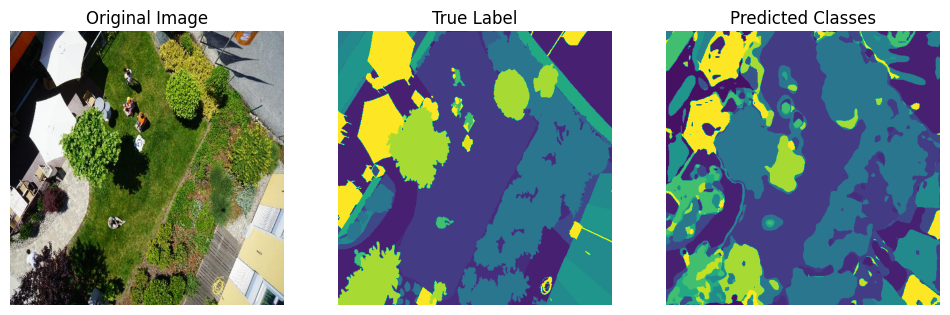

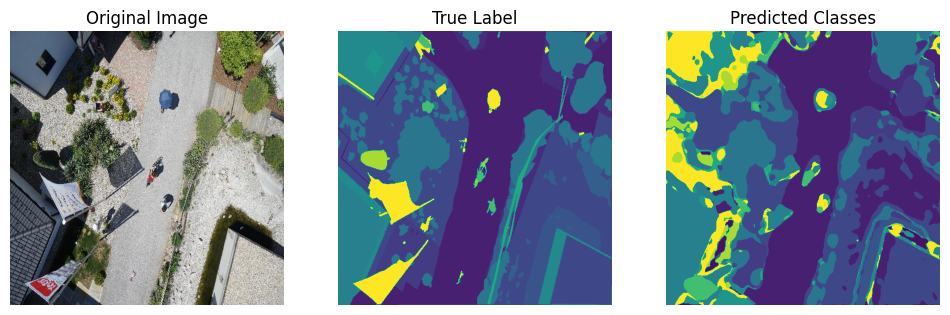

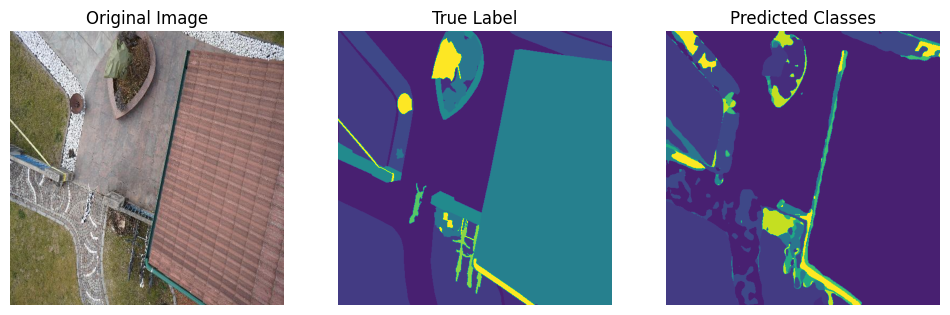

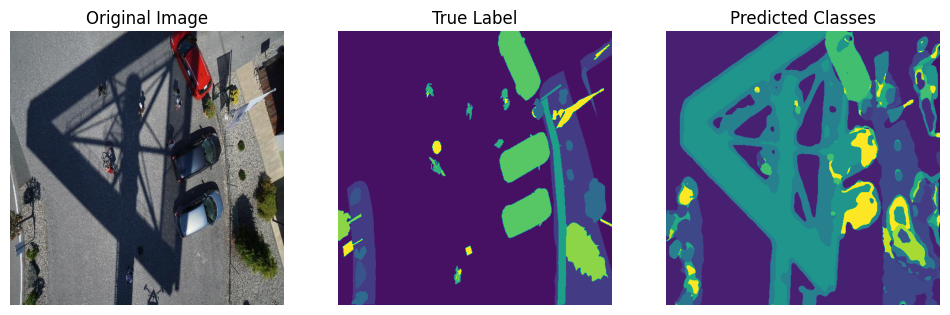

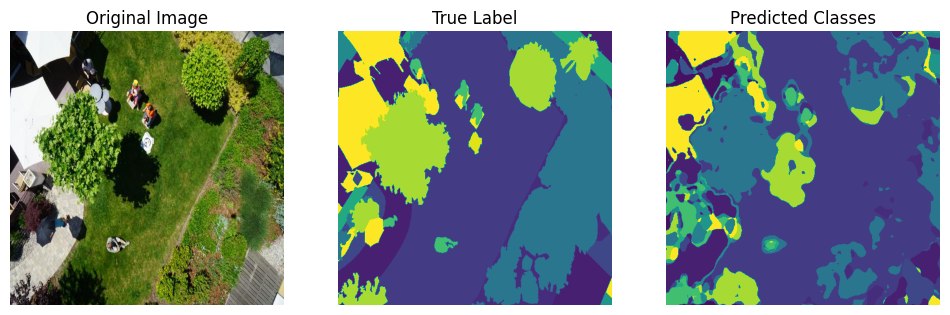

Evaluating FPN...


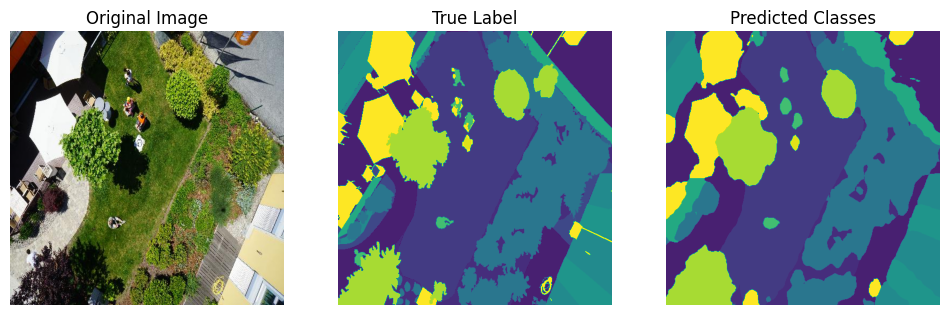

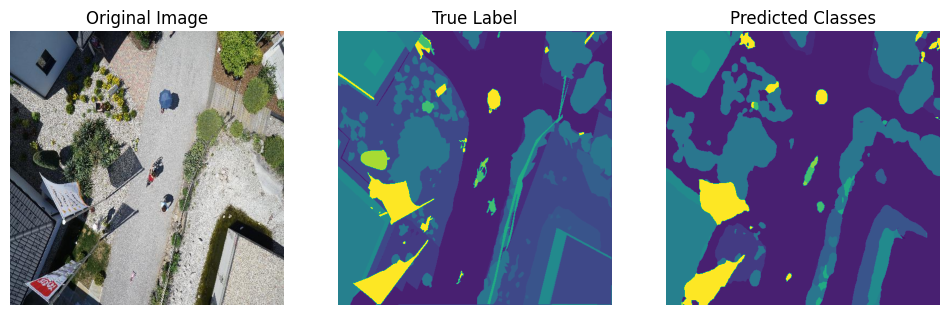

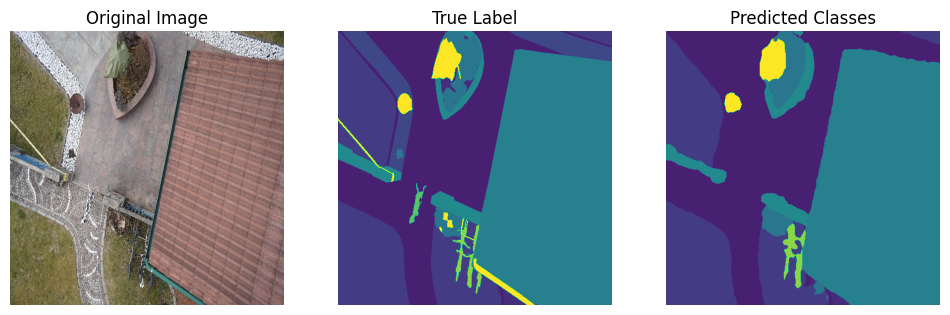

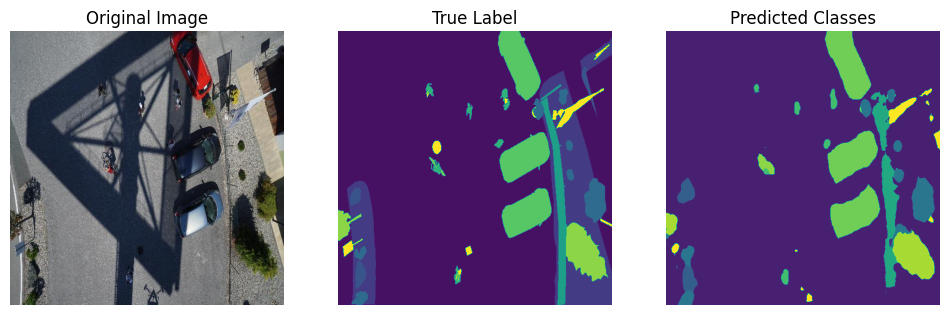

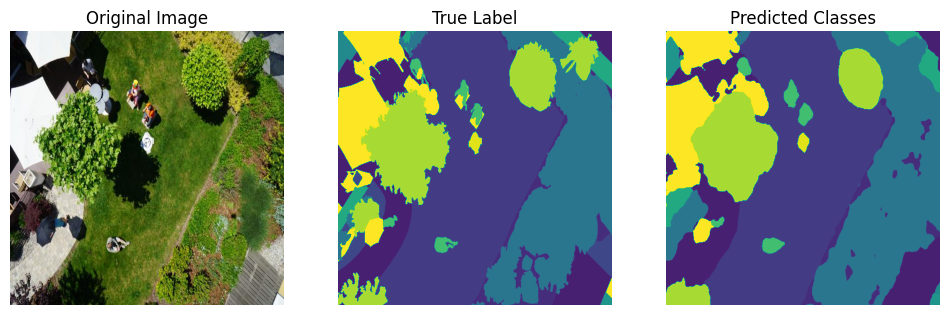

Evaluating DeepLabV3Plus...


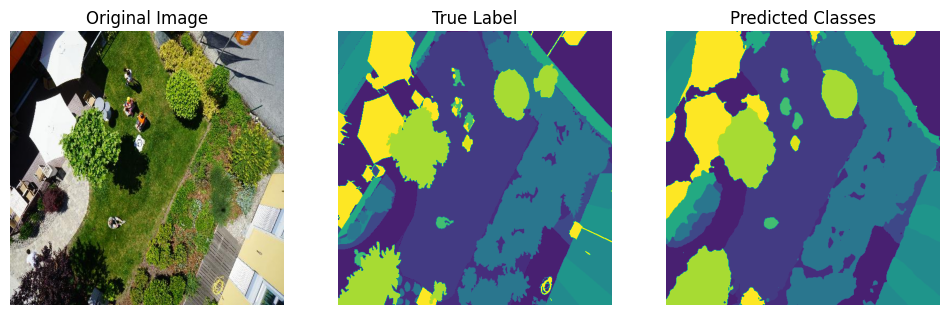

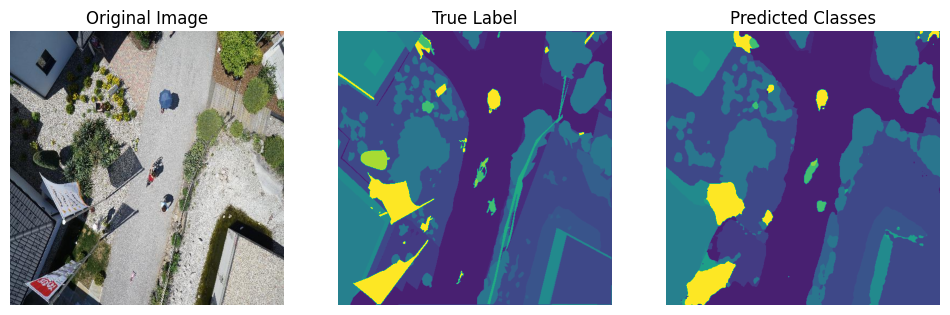

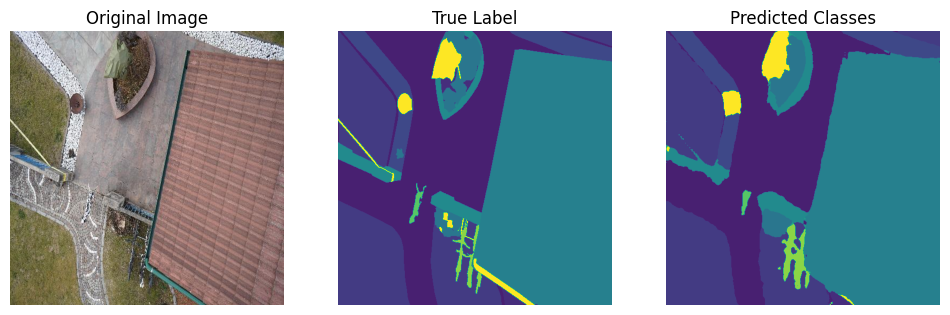

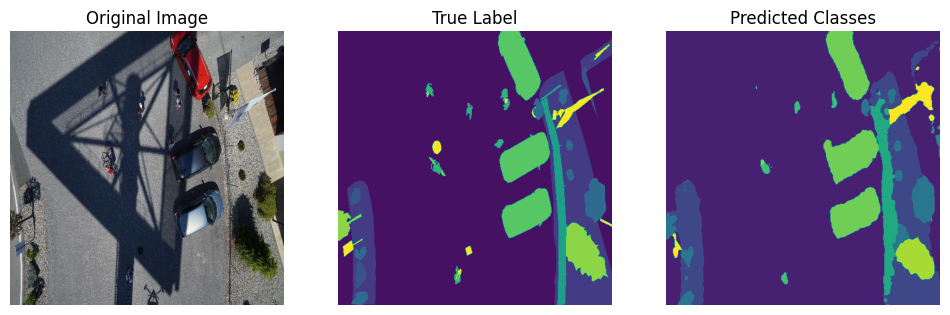

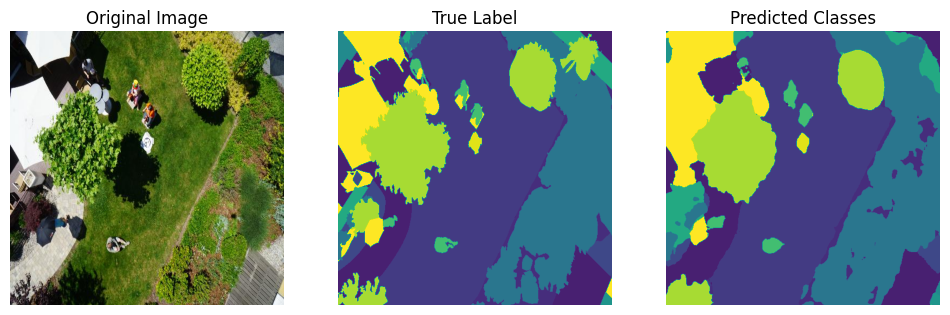

In [ ]:
def evaluate_saved_models(models, test_dataloader, device, mean, std, num_images = 2):
    for model_name, model_class in models.items():
        print(f"Evaluating {model_name}...")

        # Initialize the model architecture
        model = model_class

        # Use all the available GPUs
        model = nn.DataParallel(model)
        model.to(device)

        # Load the saved model state
        checkpoint = torch.load(f"{model_name}_best_model.pth")
        model.load_state_dict(checkpoint)

        model.eval()
        with torch.no_grad():
            for i, (images, labels) in enumerate(test_dataloader):
                images = images.to(device)
                labels = labels.to(device).long().squeeze(1)

                outputs = model(images)
                probabilities = torch.nn.functional.softmax(outputs, dim=1)
                predicted_classes = torch.argmax(probabilities, dim=1)

                plt.figure(figsize=(12, 8))

                # Display original image
                plt.subplot(1, 3, 1)
                image_denormalized = denormalize_image(images[0].permute(1, 2, 0).cpu(), mean, std)
                plt.imshow(image_denormalized)
                plt.title('Original Image')
                plt.axis('off')

                # Display true label
                plt.subplot(1, 3, 2)
                plt.imshow(labels[0].cpu().numpy(), vmin=0, vmax=23)
                plt.title('True Label')
                plt.axis('off')

                # Display predicted classes
                plt.subplot(1, 3, 3)
                plt.imshow(predicted_classes[0].cpu().numpy(), vmin=0, vmax=23)
                plt.title('Predicted Classes')
                plt.axis('off')

                plt.show()

                if i == num_images - 1:
                    break

        # Clear cache and collect garbage
        torch.cuda.empty_cache()
        gc.collect()

evaluate_saved_models(models, test_dataloader, device, mean, std, num_images = 5)

In [ ]:
from torchvision import transforms
from torch import nn
import gradio as gr
import numpy as np
from PIL import Image

# Load the saved model weights
def load_model_weights(model, model_name):
    # Load the state dict
    state_dict = torch.load(f"{model_name}_best_model.pth", map_location=torch.device('cpu'))

    # Remove the 'module.' prefix if present
    new_state_dict = {}
    for key, value in state_dict.items():
        if key.startswith("module."):
            new_state_dict[key[7:]] = value  # remove 'module.' prefix
        else:
            new_state_dict[key] = value

    # Load the new state dict into the model
    model.load_state_dict(new_state_dict)

# Load saved model weights with CPU mapping if CUDA is not available
for model_name in models:
    load_model_weights(models[model_name], model_name)
    models[model_name] = models[model_name].eval().to(device)

# Define the function to map class indices to colors
def map_class_to_color(segmented_image, class_to_color):
    color_image = np.zeros((segmented_image.shape[0], segmented_image.shape[1], 3), dtype=np.uint8)
    for class_id, color in class_to_color.items():
        color_image[segmented_image == class_id] = color
    return color_image

# Define the function to segment an image
def segment_image(image, model_name):
    # Preprocess the image
    image = Image.fromarray(image).convert("RGB")
    transform = transforms.Compose([
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    input_image = transform(image).unsqueeze(0).to(device)

    # Select the model
    model = models[model_name].to(device)

    # Perform inference
    with torch.no_grad():
        output = model(input_image)

    # Process the output
    output = torch.argmax(output.squeeze(), dim=0).cpu().numpy()

    # Map the class indices to colors
    class_to_color = {
        0: [0, 0, 0],         # unlabeled
        1: [128, 64, 128],    # paved-area
        2: [130, 76, 0],      # dirt
        3: [0, 102, 0],       # grass
        4: [112, 103, 87],    # gravel
        5: [28, 42, 168],     # water
        6: [48, 41, 30],      # rocks
        7: [0, 50, 89],       # pool
        8: [107, 142, 35],    # vegetation
        9: [70, 70, 70],      # roof
        10: [102, 102, 156],  # wall
        11: [254, 228, 12],   # window
        12: [254, 148, 12],   # door
        13: [190, 153, 153],  # fence
        14: [153, 153, 153],  # fence-pole
        15: [255, 22, 96],    # person
        16: [102, 51, 0],     # dog
        17: [9, 143, 150],    # car
        18: [119, 11, 32],    # bicycle
        19: [51, 51, 0],      # tree
        20: [190, 250, 190],  # bald-tree
        21: [112, 150, 146],  # ar-marker
        22: [2, 135, 115],    # obstacle
        23: [255, 0, 0],      # conflicting
    }
    colored_output = map_class_to_color(output, class_to_color)

    return colored_output

# Define the Gradio interface
image_input = gr.components.Image(type="numpy", label="Input Image")
model_input = gr.components.Dropdown(choices=list(models.keys()), label="Model")
output_image = gr.components.Image(type="numpy", label="Segmented Image")

# Create the Gradio interface
gr_interface = gr.Interface(
    fn=segment_image,
    inputs=[image_input, model_input],
    outputs=output_image,
    title="Semantic Segmentation",
    description="Upload an image and select a model to get the semantic segmentation."
)

# Launch the Gradio interface
gr_interface.launch(share=True)


/tmp/ipykernel_30/311564496.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f"{model_name}_best_model.pth", map_location=torch.device('cpu'))


* Running on local URL:  http://127.0.0.1:7860
* Running on public URL: https://81959be0c2a510d85c.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


# Model Training by handling outliers

##Data Augmentation with the Albumentations Library

In our dataset, we have a total of 400 images, of which 320 (80%) are used for training and 80 (20%) for validation. Given the relatively small size of the dataset, we employed data augmentation to artificially increase the training data and reduce the risk of overfitting. This process expanded the training dataset to 1,600 images, while the validation set remains at 80 images.

Data Augmentation Techniques Used:

**1. Random Cropping**

**2. Horizontal Flipping**

**3.Vertical Flipping**

**4. Rotation**

**5. Random Brightness & Contrast**

**6. Contrast Limited Adaptive Histogram Equalization (CLAHE)**

**7. Grid Distortion**

**8. Optical Distortion**

Through these techniques, we significantly enhanced our training dataset, improving the model's robustness and generalization capabilities.

# U-NET Model Training

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
import torchvision
import torch.nn.functional as F
from torch.autograd import Variable

from PIL import Image
import cv2
import albumentations as A

import time
import os
from tqdm.notebook import tqdm

!pip install -q segmentation-models-pytorch
!pip install -q torchsummary

from torchsummary import summary
import segmentation_models_pytorch as smp

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.17). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [ ]:
IMAGE_PATH = '../input/semantic-drone-dataset/dataset/semantic_drone_dataset/original_images/'
MASK_PATH = '../input/semantic-drone-dataset/dataset/semantic_drone_dataset/label_images_semantic/'

In [ ]:
n_classes = 23

def create_df():
    name = []
    for dirname, _, filenames in os.walk(IMAGE_PATH):
        for filename in filenames:
            name.append(filename.split('.')[0])

    return pd.DataFrame({'id': name}, index = np.arange(0, len(name)))

df = create_df()
print('Total Images: ', len(df))

Total Images:  400


In [ ]:
#split data
X_trainval, X_test = train_test_split(df['id'].values, test_size=0.1, random_state=19)
X_train, X_val = train_test_split(X_trainval, test_size=0.15, random_state=19)

print('Train Size   : ', len(X_train))
print('Val Size     : ', len(X_val))
print('Test Size    : ', len(X_test))

Train Size   :  306
Val Size     :  54
Test Size    :  40


Image Size (4000, 6000, 3)
Mask Size (4000, 6000)


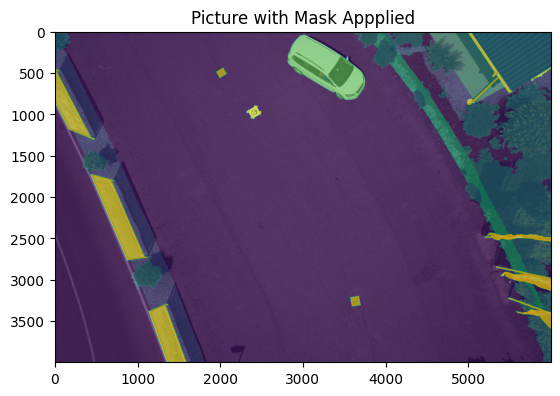

In [ ]:
img = Image.open(IMAGE_PATH + df['id'][100] + '.jpg')
mask = Image.open(MASK_PATH + df['id'][100] + '.png')
print('Image Size', np.asarray(img).shape)
print('Mask Size', np.asarray(mask).shape)


plt.imshow(img)
plt.imshow(mask, alpha=0.6)
plt.title('Picture with Mask Appplied')
plt.show()

In [ ]:
class DroneDataset(Dataset):

    def __init__(self, img_path, mask_path, X, mean, std, transform=None, patch=False):
        self.img_path = img_path
        self.mask_path = mask_path
        self.X = X
        self.transform = transform
        self.patches = patch
        self.mean = mean
        self.std = std

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        img = cv2.imread(self.img_path + self.X[idx] + '.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE)

        if self.transform is not None:
            aug = self.transform(image=img, mask=mask)
            img = Image.fromarray(aug['image'])
            mask = aug['mask']

        if self.transform is None:
            img = Image.fromarray(img)

        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        mask = torch.from_numpy(mask).long()

        if self.patches:
            img, mask = self.tiles(img, mask)

        return img, mask

    def tiles(self, img, mask):

        img_patches = img.unfold(1, 512, 512).unfold(2, 768, 768)
        img_patches  = img_patches.contiguous().view(3,-1, 512, 768)
        img_patches = img_patches.permute(1,0,2,3)

        mask_patches = mask.unfold(0, 512, 512).unfold(1, 768, 768)
        mask_patches = mask_patches.contiguous().view(-1, 512, 768)

        return img_patches, mask_patches

In [ ]:
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]

t_train = A.Compose([A.Resize(704, 1056, interpolation=cv2.INTER_NEAREST), A.HorizontalFlip(), A.VerticalFlip(),
                     A.GridDistortion(p=0.2), A.RandomBrightnessContrast((0,0.5),(0,0.5)),
                     A.GaussNoise()])

t_val = A.Compose([A.Resize(704, 1056, interpolation=cv2.INTER_NEAREST), A.HorizontalFlip(),
                   A.GridDistortion(p=0.2)])

#datasets
train_set = DroneDataset(IMAGE_PATH, MASK_PATH, X_train, mean, std, t_train, patch=False)
val_set = DroneDataset(IMAGE_PATH, MASK_PATH, X_val, mean, std, t_val, patch=False)

#dataloader
batch_size= 3

train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=True)

In [ ]:
model = smp.Unet('mobilenet_v2', encoder_weights='imagenet', classes=23, activation=None, encoder_depth=5, decoder_channels=[256, 128, 64, 32, 16])
model

Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 255MB/s]


Unet(
  (encoder): MobileNetV2Encoder(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (1): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU6(inplace=True)
          )
          (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (2): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 96, kernel_size=(1

In [ ]:
def pixel_accuracy(output, mask):
    with torch.no_grad():
        output = torch.argmax(F.softmax(output, dim=1), dim=1)
        correct = torch.eq(output, mask).int()
        accuracy = float(correct.sum()) / float(correct.numel())
    return accuracy

In [ ]:
def mIoU(pred_mask, mask, smooth=1e-10, n_classes=23):
    with torch.no_grad():
        pred_mask = F.softmax(pred_mask, dim=1)
        pred_mask = torch.argmax(pred_mask, dim=1)
        pred_mask = pred_mask.contiguous().view(-1)
        mask = mask.contiguous().view(-1)

        iou_per_class = []
        for clas in range(0, n_classes): #loop per pixel class
            true_class = pred_mask == clas
            true_label = mask == clas

            if true_label.long().sum().item() == 0: #no exist label in this loop
                iou_per_class.append(np.nan)
            else:
                intersect = torch.logical_and(true_class, true_label).sum().float().item()
                union = torch.logical_or(true_class, true_label).sum().float().item()

                iou = (intersect + smooth) / (union +smooth)
                iou_per_class.append(iou)
        return np.nanmean(iou_per_class)

In [ ]:
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

def fit(epochs, model, train_loader, val_loader, criterion, optimizer, scheduler, patch=False):
    torch.cuda.empty_cache()
    train_losses = []
    test_losses = []
    val_iou = []; val_acc = []
    train_iou = []; train_acc = []
    lrs = []
    min_loss = np.inf
    decrease = 1 ; not_improve=0

    model.to(device)
    fit_time = time.time()
    for e in range(epochs):
        since = time.time()
        running_loss = 0
        iou_score = 0
        accuracy = 0
        #training loop
        model.train()
        for i, data in enumerate(tqdm(train_loader)):
            #training phase
            image_tiles, mask_tiles = data
            if patch:
                bs, n_tiles, c, h, w = image_tiles.size()

                image_tiles = image_tiles.view(-1,c, h, w)
                mask_tiles = mask_tiles.view(-1, h, w)

            image = image_tiles.to(device); mask = mask_tiles.to(device);
            #forward
            output = model(image)
            loss = criterion(output, mask)
            #evaluation metrics
            iou_score += mIoU(output, mask)
            accuracy += pixel_accuracy(output, mask)
            #backward
            loss.backward()
            optimizer.step() #update weight
            optimizer.zero_grad() #reset gradient

            #step the learning rate
            lrs.append(get_lr(optimizer))
            scheduler.step()

            running_loss += loss.item()

        else:
            model.eval()
            test_loss = 0
            test_accuracy = 0
            val_iou_score = 0
            #validation loop
            with torch.no_grad():
                for i, data in enumerate(tqdm(val_loader)):
                    #reshape to 9 patches from single image, delete batch size
                    image_tiles, mask_tiles = data

                    if patch:
                        bs, n_tiles, c, h, w = image_tiles.size()

                        image_tiles = image_tiles.view(-1,c, h, w)
                        mask_tiles = mask_tiles.view(-1, h, w)

                    image = image_tiles.to(device); mask = mask_tiles.to(device);
                    output = model(image)
                    #evaluation metrics
                    val_iou_score +=  mIoU(output, mask)
                    test_accuracy += pixel_accuracy(output, mask)
                    #loss
                    loss = criterion(output, mask)
                    test_loss += loss.item()

            #calculatio mean for each batch
            train_losses.append(running_loss/len(train_loader))
            test_losses.append(test_loss/len(val_loader))


            if min_loss > (test_loss/len(val_loader)):
                print('Loss Decreasing.. {:.3f} >> {:.3f} '.format(min_loss, (test_loss/len(val_loader))))
                min_loss = (test_loss/len(val_loader))
                decrease += 1
                if decrease % 5 == 0:
                    print('saving model...')
                    torch.save(model, 'Unet-Mobilenet_v2_mIoU-{:.3f}.pt'.format(val_iou_score/len(val_loader)))


            if (test_loss/len(val_loader)) > min_loss:
                not_improve += 1
                min_loss = (test_loss/len(val_loader))
                print(f'Loss Not Decrease for {not_improve} time')
                if not_improve == 7:
                    print('Loss not decrease for 7 times, Stop Training')
                    break

            #iou
            val_iou.append(val_iou_score/len(val_loader))
            train_iou.append(iou_score/len(train_loader))
            train_acc.append(accuracy/len(train_loader))
            val_acc.append(test_accuracy/ len(val_loader))
            print("Epoch:{}/{}..".format(e+1, epochs),
                  "Train Loss: {:.3f}..".format(running_loss/len(train_loader)),
                  "Val Loss: {:.3f}..".format(test_loss/len(val_loader)),
                  "Train mIoU:{:.3f}..".format(iou_score/len(train_loader)),
                  "Val mIoU: {:.3f}..".format(val_iou_score/len(val_loader)),
                  "Train Acc:{:.3f}..".format(accuracy/len(train_loader)),
                  "Val Acc:{:.3f}..".format(test_accuracy/len(val_loader)),
                  "Time: {:.2f}m".format((time.time()-since)/60))

    history = {'train_loss' : train_losses, 'val_loss': test_losses,
               'train_miou' :train_iou, 'val_miou':val_iou,
               'train_acc' :train_acc, 'val_acc':val_acc,
               'lrs': lrs}
    print('Total time: {:.2f} m' .format((time.time()- fit_time)/60))
    return history

In [ ]:
max_lr = 1e-3
epoch = 15
weight_decay = 1e-4

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=max_lr, weight_decay=weight_decay)
sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr, epochs=epoch,
                                            steps_per_epoch=len(train_loader))

history = fit(epoch, model, train_loader, val_loader, criterion, optimizer, sched)

  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. inf >> 1.914 
Epoch:1/15.. Train Loss: 2.771.. Val Loss: 1.914.. Train mIoU:0.049.. Val mIoU: 0.106.. Train Acc:0.253.. Val Acc:0.555.. Time: 3.08m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 1.914 >> 1.273 
Epoch:2/15.. Train Loss: 1.825.. Val Loss: 1.273.. Train mIoU:0.118.. Val mIoU: 0.163.. Train Acc:0.583.. Val Acc:0.713.. Time: 3.07m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 1.273 >> 1.092 
Epoch:3/15.. Train Loss: 1.499.. Val Loss: 1.092.. Train mIoU:0.137.. Val mIoU: 0.178.. Train Acc:0.618.. Val Acc:0.728.. Time: 3.09m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Not Decrease for 1 time
Epoch:4/15.. Train Loss: 1.364.. Val Loss: 1.180.. Train mIoU:0.157.. Val mIoU: 0.170.. Train Acc:0.628.. Val Acc:0.705.. Time: 3.10m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 1.180 >> 0.861 
saving model...
Epoch:5/15.. Train Loss: 1.196.. Val Loss: 0.861.. Train mIoU:0.186.. Val mIoU: 0.223.. Train Acc:0.661.. Val Acc:0.763.. Time: 3.08m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Not Decrease for 2 time
Epoch:6/15.. Train Loss: 1.116.. Val Loss: 1.039.. Train mIoU:0.201.. Val mIoU: 0.194.. Train Acc:0.684.. Val Acc:0.686.. Time: 3.07m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 1.039 >> 0.847 
Epoch:7/15.. Train Loss: 1.059.. Val Loss: 0.847.. Train mIoU:0.212.. Val mIoU: 0.232.. Train Acc:0.696.. Val Acc:0.764.. Time: 3.06m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.847 >> 0.771 
Epoch:8/15.. Train Loss: 0.951.. Val Loss: 0.771.. Train mIoU:0.233.. Val mIoU: 0.248.. Train Acc:0.728.. Val Acc:0.773.. Time: 3.07m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.771 >> 0.759 
Epoch:9/15.. Train Loss: 0.903.. Val Loss: 0.759.. Train mIoU:0.239.. Val mIoU: 0.247.. Train Acc:0.740.. Val Acc:0.775.. Time: 3.10m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.759 >> 0.683 
Epoch:10/15.. Train Loss: 0.826.. Val Loss: 0.683.. Train mIoU:0.256.. Val mIoU: 0.272.. Train Acc:0.756.. Val Acc:0.792.. Time: 3.08m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.683 >> 0.643 
saving model...
Epoch:11/15.. Train Loss: 0.790.. Val Loss: 0.643.. Train mIoU:0.267.. Val mIoU: 0.298.. Train Acc:0.769.. Val Acc:0.811.. Time: 3.05m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.643 >> 0.620 
Epoch:12/15.. Train Loss: 0.718.. Val Loss: 0.620.. Train mIoU:0.292.. Val mIoU: 0.304.. Train Acc:0.790.. Val Acc:0.819.. Time: 3.06m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.620 >> 0.588 
Epoch:13/15.. Train Loss: 0.657.. Val Loss: 0.588.. Train mIoU:0.306.. Val mIoU: 0.324.. Train Acc:0.808.. Val Acc:0.828.. Time: 3.06m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.588 >> 0.583 
Epoch:14/15.. Train Loss: 0.641.. Val Loss: 0.583.. Train mIoU:0.314.. Val mIoU: 0.319.. Train Acc:0.814.. Val Acc:0.830.. Time: 3.07m


  0%|          | 0/102 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

Loss Decreasing.. 0.583 >> 0.578 
Epoch:15/15.. Train Loss: 0.616.. Val Loss: 0.578.. Train mIoU:0.324.. Val mIoU: 0.331.. Train Acc:0.823.. Val Acc:0.833.. Time: 3.04m
Total time: 46.09 m


In [ ]:
torch.save(model, 'Unet-Mobilenet.pt')

In [ ]:
def plot_loss(history):
    plt.plot(history['val_loss'], label='val', marker='o')
    plt.plot( history['train_loss'], label='train', marker='o')
    plt.title('Loss per epoch'); plt.ylabel('loss');
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()

def plot_score(history):
    plt.plot(history['train_miou'], label='train_mIoU', marker='*')
    plt.plot(history['val_miou'], label='val_mIoU',  marker='*')
    plt.title('Score per epoch'); plt.ylabel('mean IoU')
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()

def plot_acc(history):
    plt.plot(history['train_acc'], label='train_accuracy', marker='*')
    plt.plot(history['val_acc'], label='val_accuracy',  marker='*')
    plt.title('Accuracy per epoch'); plt.ylabel('Accuracy')
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()

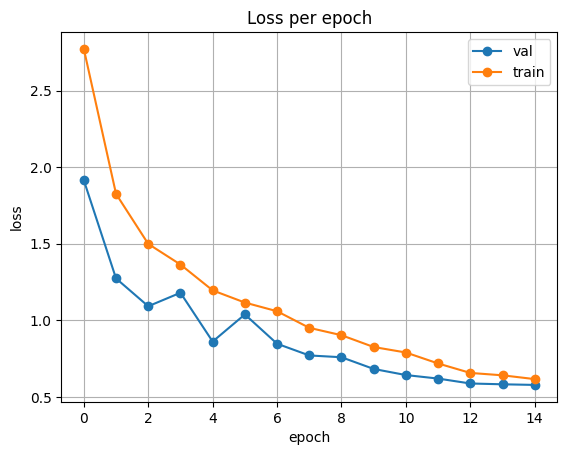

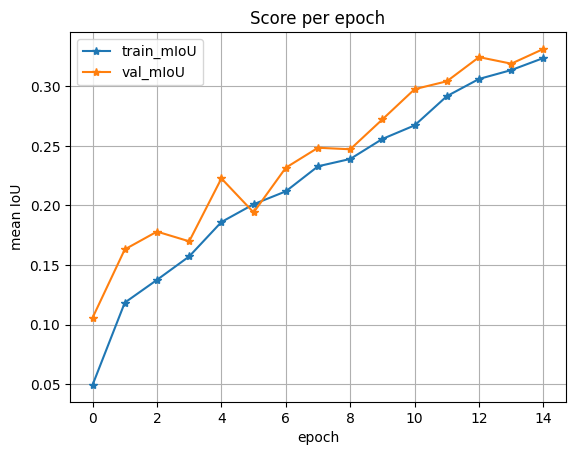

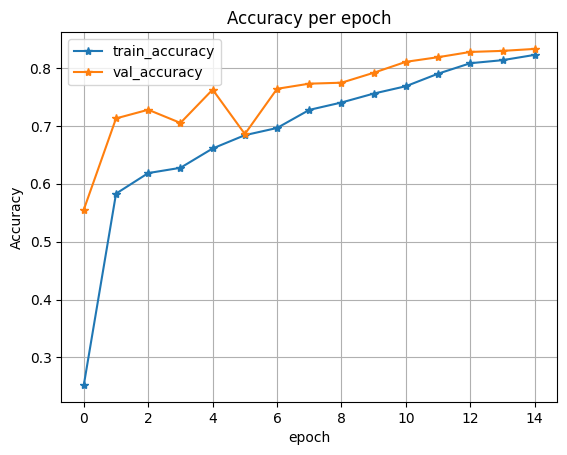

In [ ]:
plot_loss(history)
plot_score(history)
plot_acc(history)

In [ ]:
class DroneTestDataset(Dataset):

    def __init__(self, img_path, mask_path, X, transform=None):
        self.img_path = img_path
        self.mask_path = mask_path
        self.X = X
        self.transform = transform

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        img = cv2.imread(self.img_path + self.X[idx] + '.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE)

        if self.transform is not None:
            aug = self.transform(image=img, mask=mask)
            img = Image.fromarray(aug['image'])
            mask = aug['mask']

        if self.transform is None:
            img = Image.fromarray(img)

        mask = torch.from_numpy(mask).long()

        return img, mask


t_test = A.Resize(768, 1152, interpolation=cv2.INTER_NEAREST)
test_set = DroneTestDataset(IMAGE_PATH, MASK_PATH, X_test, transform=t_test)

In [ ]:
def predict_image_mask_miou(model, image, mask, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():

        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)

        output = model(image)
        score = mIoU(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, score

In [ ]:
def predict_image_mask_pixel(model, image, mask, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():

        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)

        output = model(image)
        acc = pixel_accuracy(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, acc

In [ ]:
image, mask = test_set[3]
pred_mask, score = predict_image_mask_miou(model, image, mask)

In [ ]:
def miou_score(model, test_set):
    score_iou = []
    for i in tqdm(range(len(test_set))):
        img, mask = test_set[i]
        pred_mask, score = predict_image_mask_miou(model, img, mask)
        score_iou.append(score)
    return score_iou

In [ ]:
mob_miou = miou_score(model, test_set)

  0%|          | 0/40 [00:00<?, ?it/s]

In [ ]:
def pixel_acc(model, test_set):
    accuracy = []
    for i in tqdm(range(len(test_set))):
        img, mask = test_set[i]
        pred_mask, acc = predict_image_mask_pixel(model, img, mask)
        accuracy.append(acc)
    return accuracy

In [ ]:
mob_acc = pixel_acc(model, test_set)

  0%|          | 0/40 [00:00<?, ?it/s]

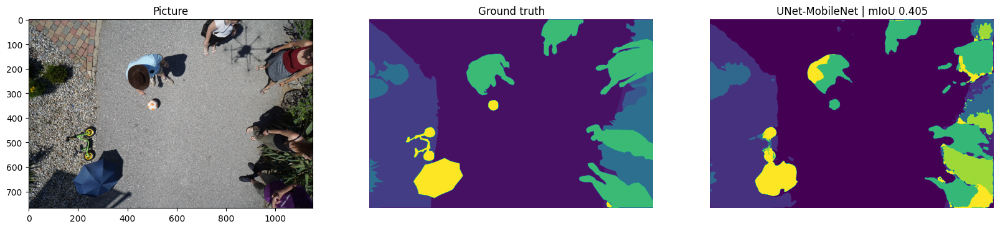

In [ ]:
fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.imshow(image)
ax1.set_title('Picture');

ax2.imshow(mask)
ax2.set_title('Ground truth')
ax2.set_axis_off()

ax3.imshow(pred_mask)
ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score))
ax3.set_axis_off()

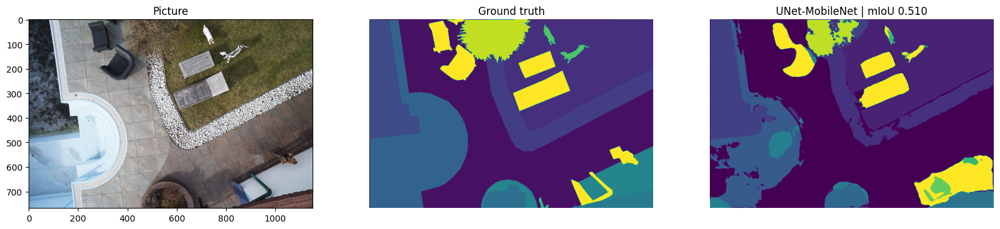

In [ ]:
image2, mask2 = test_set[4]
pred_mask2, score2 = predict_image_mask_miou(model, image2, mask2)

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.imshow(image2)
ax1.set_title('Picture');

ax2.imshow(mask2)
ax2.set_title('Ground truth')
ax2.set_axis_off()

ax3.imshow(pred_mask2)
ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score2))
ax3.set_axis_off()

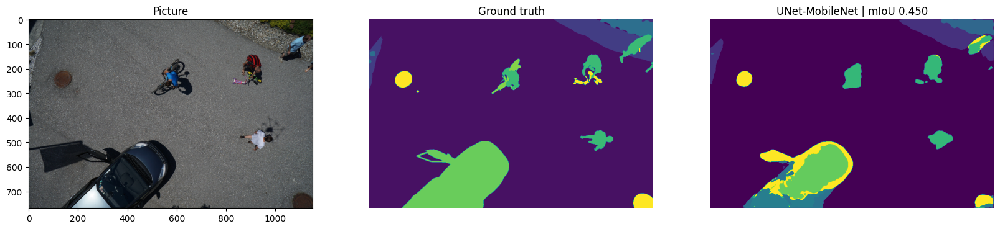

In [ ]:
image3, mask3 = test_set[6]
pred_mask3, score3 = predict_image_mask_miou(model, image3, mask3)

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.imshow(image3)
ax1.set_title('Picture');

ax2.imshow(mask3)
ax2.set_title('Ground truth')
ax2.set_axis_off()

ax3.imshow(pred_mask3)
ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score3))
ax3.set_axis_off()

In [ ]:
print('Test Set mIoU', np.mean(mob_miou))
print('Test Set Pixel Accuracy', np.mean(mob_acc))

Test Set mIoU 0.3503019762766226
Test Set Pixel Accuracy 0.8128118726942276
